<a href="https://colab.research.google.com/github/Sherryli443/Cell_detection/blob/cellmaster/Test_Differential_Clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Test Code

In [1]:
!cd '/content/drive/MyDrive/Colab Notebooks/EM_DATA/pytorch-unsupervised-segmentation-tip' &&\
 python demo.py --input BSD500/101027.jpg

/bin/bash: line 0: cd: /content/drive/MyDrive/Colab Notebooks/EM_DATA/pytorch-unsupervised-segmentation-tip: No such file or directory


## Adapted to Colab

### Import libraries

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable
import cv2
import sys
import numpy as np
import torch.nn.init
import random
from google.colab.patches import cv2_imshow
from skimage.exposure import equalize_adapthist as Clahe 

use_cuda = torch.cuda.is_available()

### Define a general function

In [ ]:
def unsupervised_differentiable_clustering(input, output_name, scribble=False, nChannel=100, 
                                           maxIter=1000, minLabels=3,
                                           lr=0.1, nConv=2, visualize=1,
                                           stepsize_sim=1, stepsize_con=1,
                                           stepsize_scr=0.5):
  """ Converted .py code into a function. Trains an image to cluster into different regions.
  Args:
    input: Path to the image
    scribble: scribble to help segmentation
    nChannel: number of channels produced by the convolution
    maxIter: maximum number of iterations
    minLabels: minimum number of regions to segment
    lr: learning rate
    nConv: number of convolution layers
    visualize: show image in training
    stepsize_sim: idk
    stepsize_con: idk
    stepsize_scr: idk
    """
  # CNN model
  class MyNet(nn.Module):
      def __init__(self,input_dim):
          super(MyNet, self).__init__()
          self.conv1 = nn.Conv2d(input_dim, nChannel, kernel_size=3, stride=1, padding=1 )
          self.bn1 = nn.BatchNorm2d(nChannel)
          self.conv2 = nn.ModuleList()
          self.bn2 = nn.ModuleList()
          for i in range(nConv-1):
              self.conv2.append( nn.Conv2d(nChannel, nChannel, kernel_size=3, stride=1, padding=1 ) )
              self.bn2.append( nn.BatchNorm2d(nChannel) )
          self.conv3 = nn.Conv2d(nChannel, nChannel, kernel_size=1, stride=1, padding=0 )
          self.bn3 = nn.BatchNorm2d(nChannel)

      def forward(self, x):
          x = self.conv1(x)
          x = F.relu( x )
          x = self.bn1(x)
          for i in range(nConv-1):
              x = self.conv2[i](x)
              x = F.relu( x )
              x = self.bn2[i](x)
          x = self.conv3(x)
          x = self.bn3(x)
          return x

  # load image
  im = cv2.imread(input)
  cv2_imshow(im)
  im = Clahe(im)
  im = (255*im/np.max(im)).astype(np.uint8) 
  cv2_imshow(im)
  data = torch.from_numpy( np.array([im.transpose( (2, 0, 1) ).astype('float32')/255.]) )
  if use_cuda:
      data = data.cuda()
  data = Variable(data)

  # load scribble
  if scribble:
      mask = cv2.imread(input.replace('.'+input.split('.')[-1],'_scribble.png'),-1)
      mask = mask.reshape(-1)
      mask_inds = np.unique(mask)
      mask_inds = np.delete( mask_inds, np.argwhere(mask_inds==255) )
      inds_sim = torch.from_numpy( np.where( mask == 255 )[ 0 ] )
      inds_scr = torch.from_numpy( np.where( mask != 255 )[ 0 ] )
      target_scr = torch.from_numpy( mask.astype(np.int) )
      if use_cuda:
          inds_sim = inds_sim.cuda()
          inds_scr = inds_scr.cuda()
          target_scr = target_scr.cuda()
      target_scr = Variable( target_scr )
      # set minLabels
      minLabels = len(mask_inds)

  # train
  model = MyNet( data.size(1) )
  if use_cuda:
      model.cuda()
  model.train()

  # similarity loss definition
  loss_fn = torch.nn.CrossEntropyLoss()

  # scribble loss definition
  loss_fn_scr = torch.nn.CrossEntropyLoss()

  # continuity loss definition
  loss_hpy = torch.nn.L1Loss(size_average = True)
  loss_hpz = torch.nn.L1Loss(size_average = True)

  HPy_target = torch.zeros(im.shape[0]-1, im.shape[1], nChannel)
  HPz_target = torch.zeros(im.shape[0], im.shape[1]-1, nChannel)
  if use_cuda:
      HPy_target = HPy_target.cuda()
      HPz_target = HPz_target.cuda()
      
  optimizer = optim.SGD(model.parameters(), lr=lr, momentum=0.9)
  label_colours = np.random.randint(255,size=(100,3))

  for batch_idx in range(maxIter):
      # forwarding
      optimizer.zero_grad()
      output = model( data )[ 0 ]
      output = output.permute( 1, 2, 0 ).contiguous().view( -1, nChannel )

      outputHP = output.reshape( (im.shape[0], im.shape[1], nChannel) )
      HPy = outputHP[1:, :, :] - outputHP[0:-1, :, :]
      HPz = outputHP[:, 1:, :] - outputHP[:, 0:-1, :]
      lhpy = loss_hpy(HPy,HPy_target)
      lhpz = loss_hpz(HPz,HPz_target)

      ignore, target = torch.max( output, 1 )
      im_target = target.data.cpu().numpy()
      nLabels = len(np.unique(im_target))
      if visualize:
          im_target_rgb = np.array([label_colours[ c % nChannel ] for c in im_target])
          im_target_rgb = im_target_rgb.reshape( im.shape ).astype( np.uint8 )
          cv2_imshow(im_target_rgb)
          cv2.waitKey(10)

      # loss 
      if scribble:
          loss = stepsize_sim * loss_fn(output[ inds_sim ], target[ inds_sim ]) + stepsize_scr * loss_fn_scr(output[ inds_scr ], target_scr[ inds_scr ]) + stepsize_con * (lhpy + lhpz)
      else:
          loss = stepsize_sim * loss_fn(output, target) + stepsize_con * (lhpy + lhpz)
          
      loss.backward()
      optimizer.step()

      print (batch_idx, '/', maxIter, '|', ' label num :', nLabels, ' | loss :', loss.item())

      if nLabels <= minLabels:
          print ("nLabels", nLabels, "reached minLabels", minLabels, ".")
          break

  # save output image
  if not visualize:
      output = model( data )[ 0 ]
      output = output.permute( 1, 2, 0 ).contiguous().view( -1, nChannel )
      ignore, target = torch.max( output, 1 )
      im_target = target.data.cpu().numpy()
      im_target_rgb = np.array([label_colours[ c % nChannel ] for c in im_target])
      im_target_rgb = im_target_rgb.reshape( im.shape ).astype( np.uint8 )
  cv2.imwrite( output_name, im_target_rgb ) 

## Just call the function !

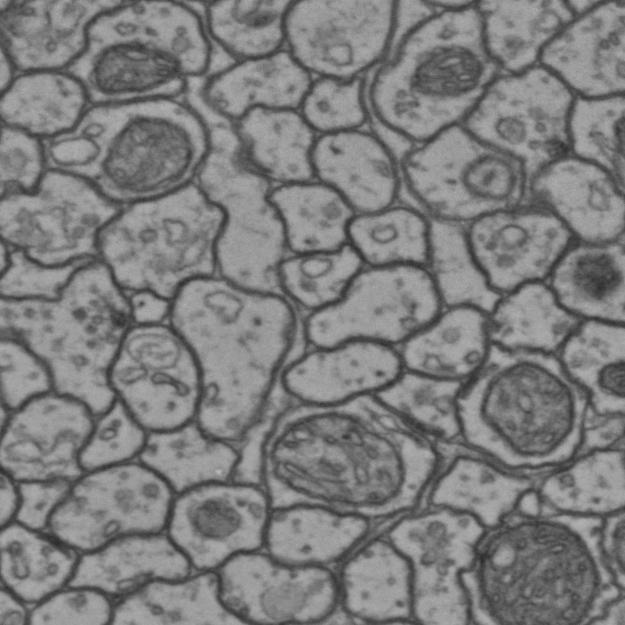

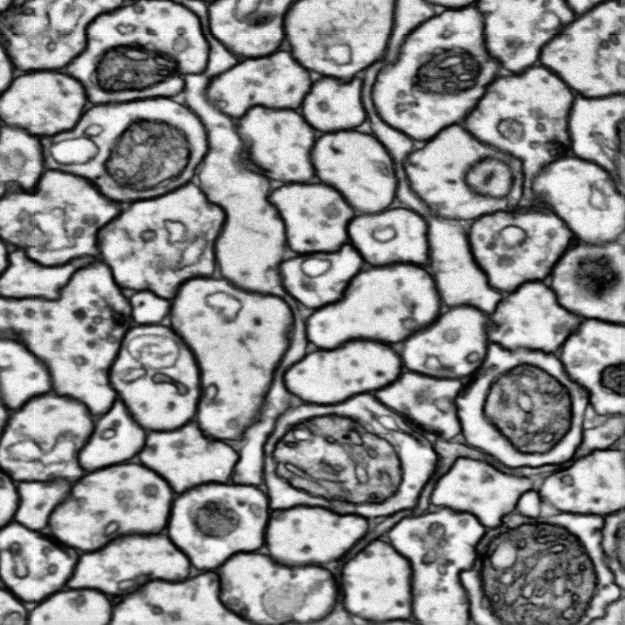

/usr/local/lib/python3.7/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


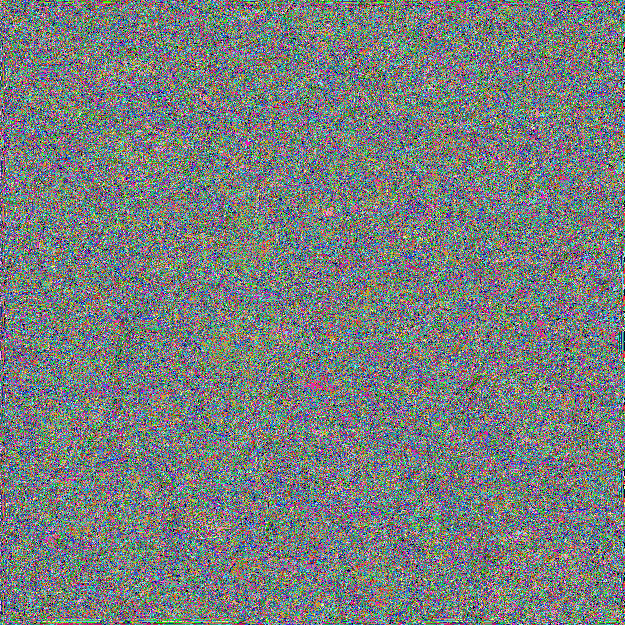

0 / 300 |  label num : 100  | loss : 4.4904069900512695


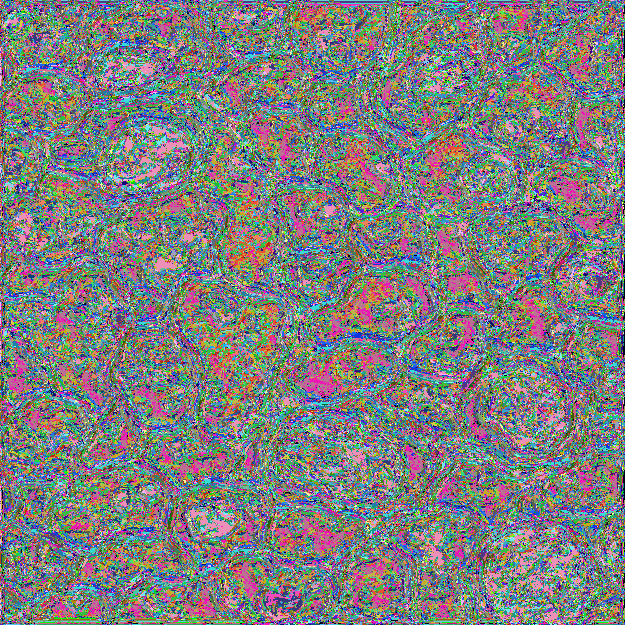

1 / 300 |  label num : 100  | loss : 3.8715317249298096


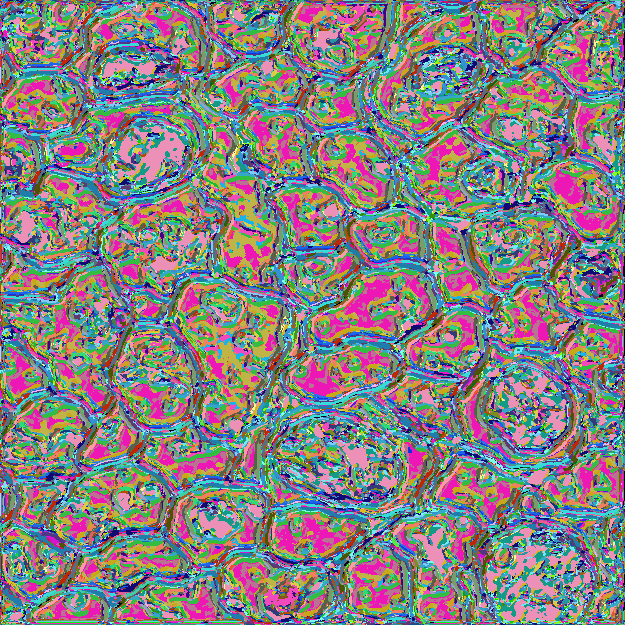

2 / 300 |  label num : 100  | loss : 3.1905577182769775


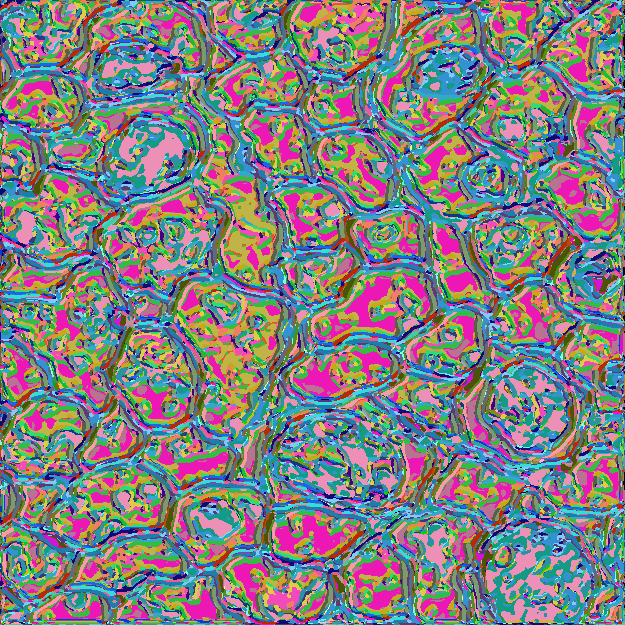

3 / 300 |  label num : 98  | loss : 2.726283311843872


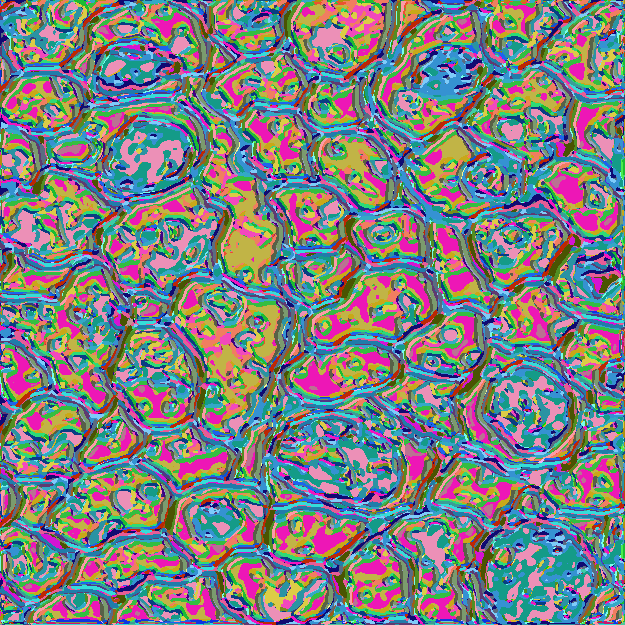

4 / 300 |  label num : 88  | loss : 2.4012579917907715


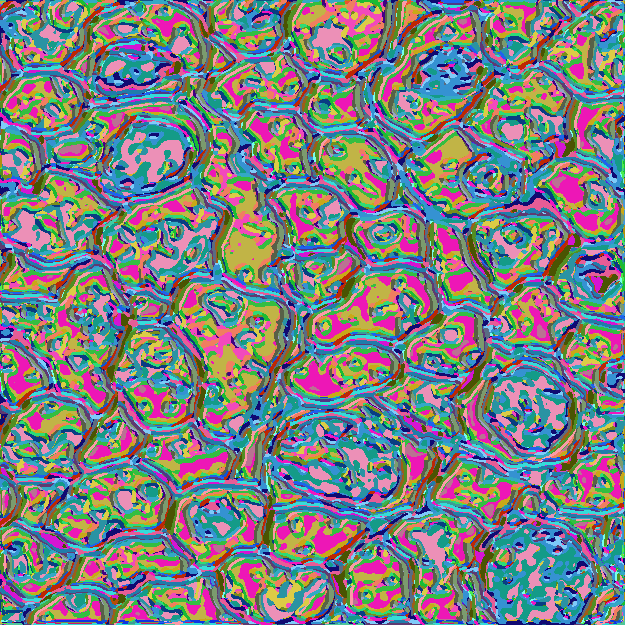

5 / 300 |  label num : 86  | loss : 2.1560792922973633


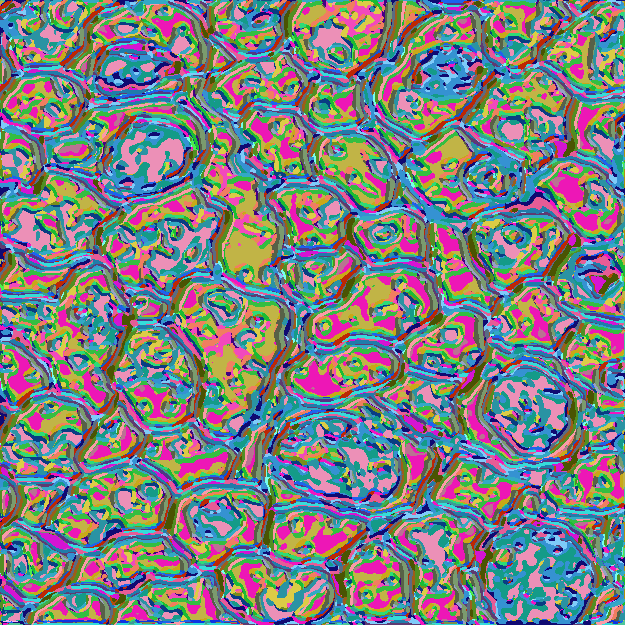

6 / 300 |  label num : 75  | loss : 1.9410885572433472


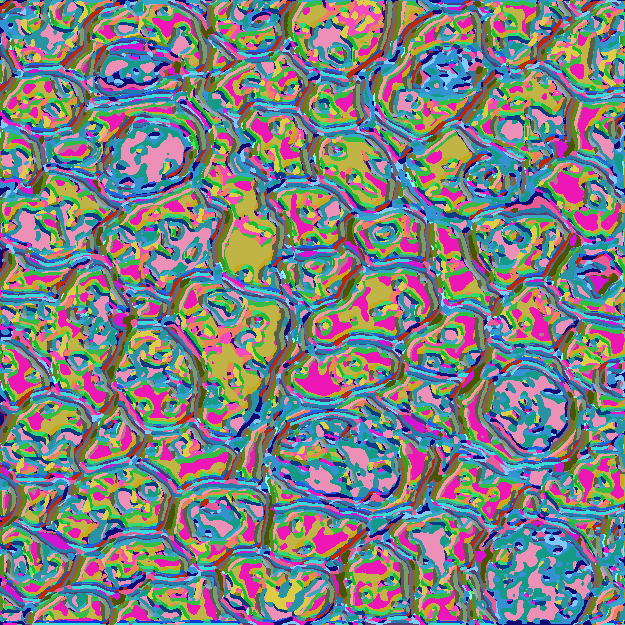

7 / 300 |  label num : 74  | loss : 1.7659071683883667


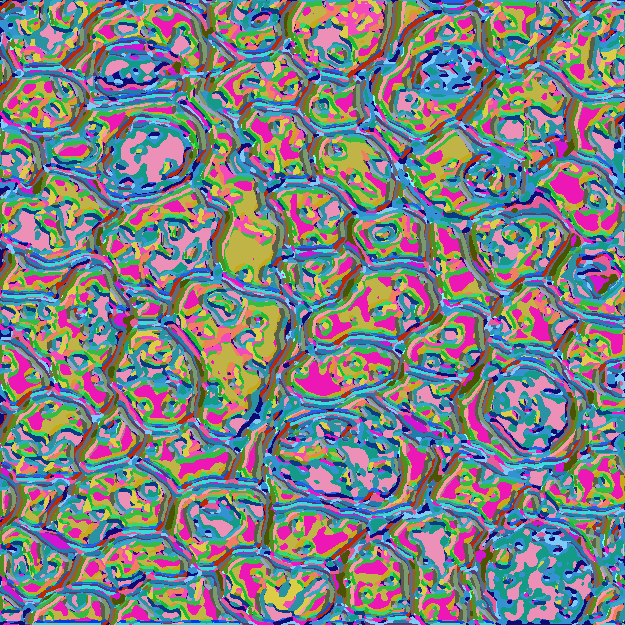

8 / 300 |  label num : 65  | loss : 1.6009365320205688


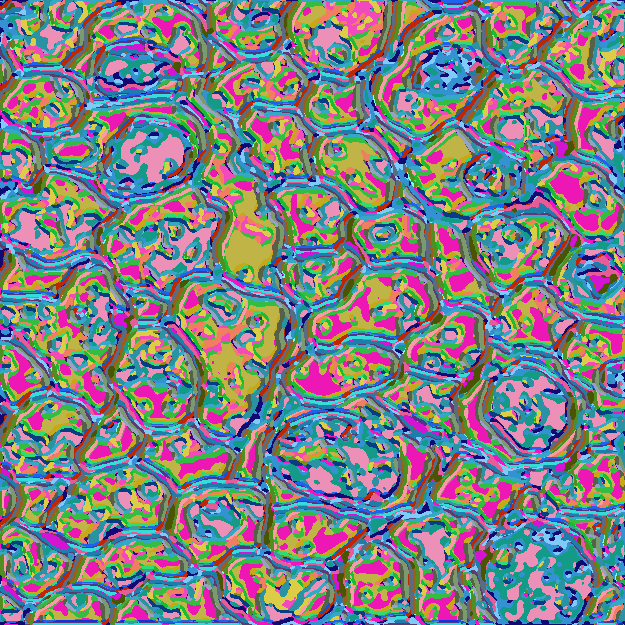

9 / 300 |  label num : 58  | loss : 1.4537254571914673


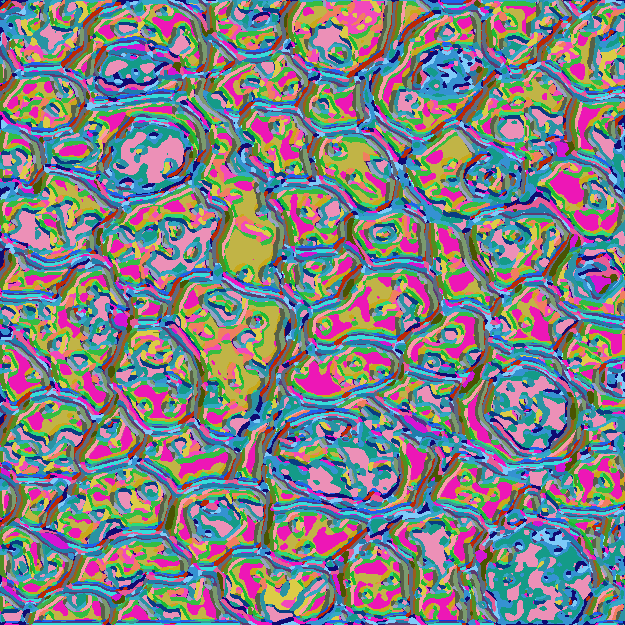

10 / 300 |  label num : 50  | loss : 1.3214517831802368


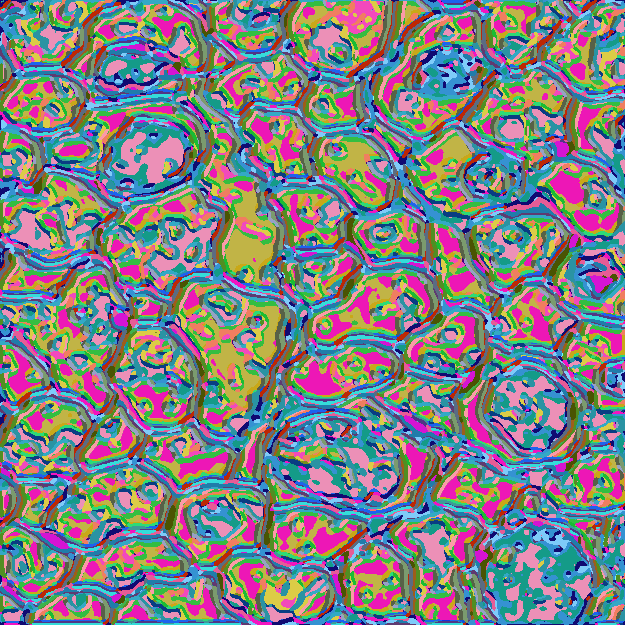

11 / 300 |  label num : 49  | loss : 1.2074226140975952


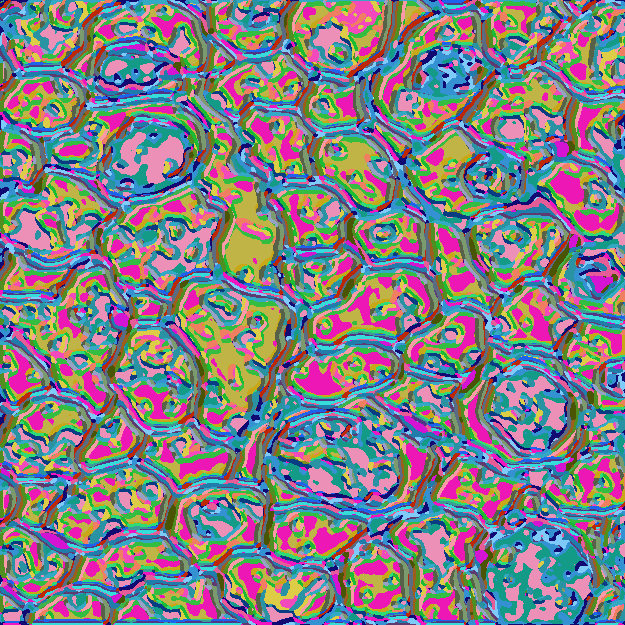

12 / 300 |  label num : 45  | loss : 1.104846477508545


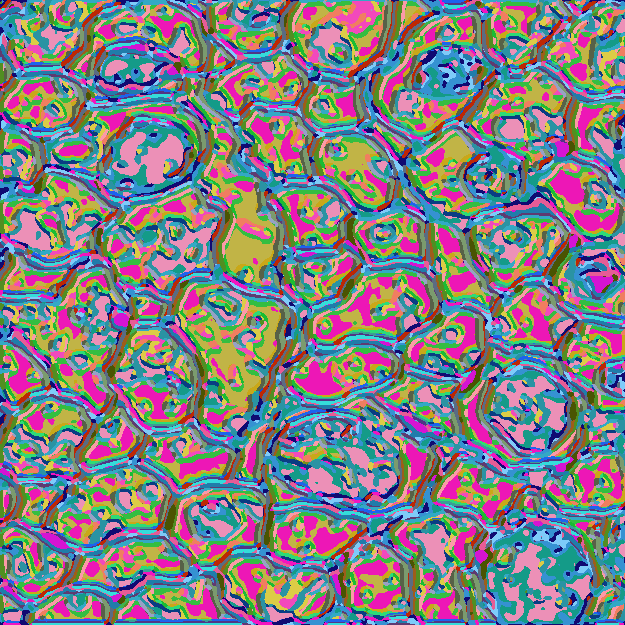

13 / 300 |  label num : 44  | loss : 1.0139598846435547


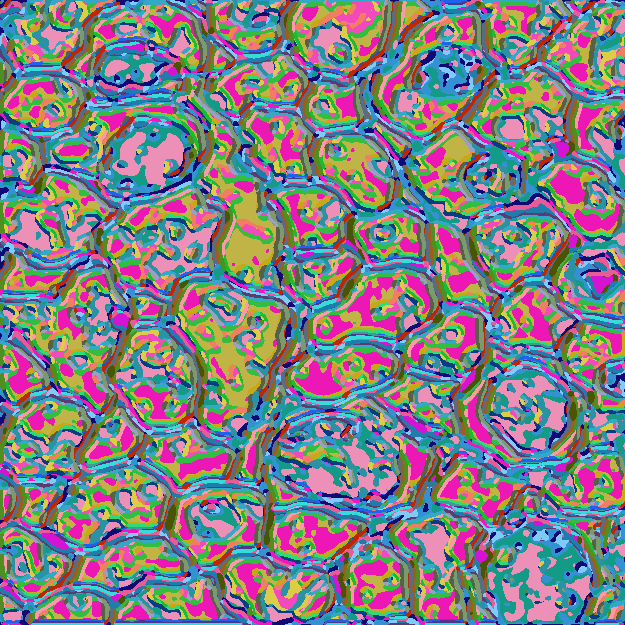

14 / 300 |  label num : 42  | loss : 0.9361667037010193


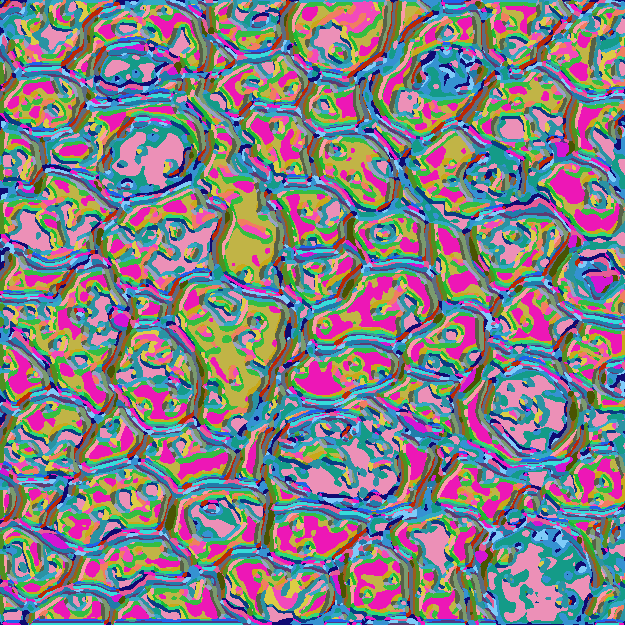

15 / 300 |  label num : 40  | loss : 0.8681376576423645


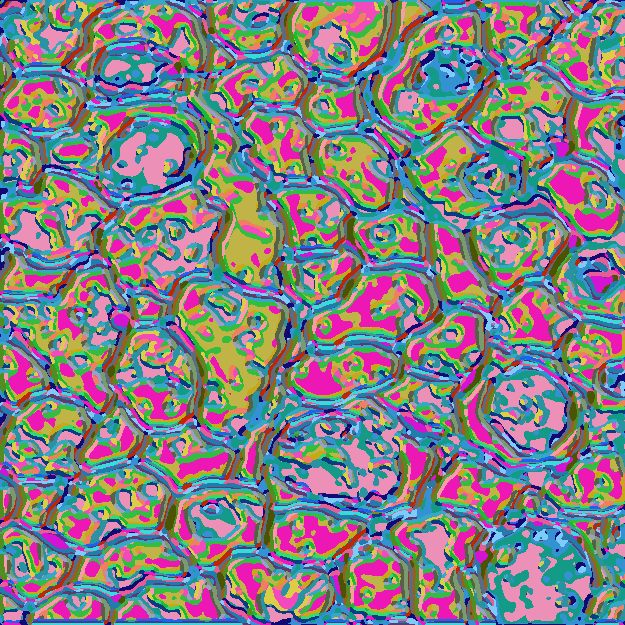

16 / 300 |  label num : 39  | loss : 0.8069614768028259


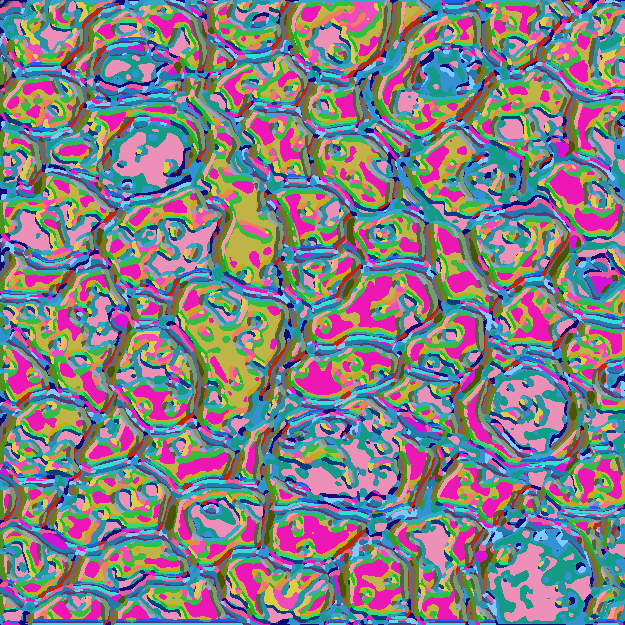

17 / 300 |  label num : 39  | loss : 0.7525897026062012


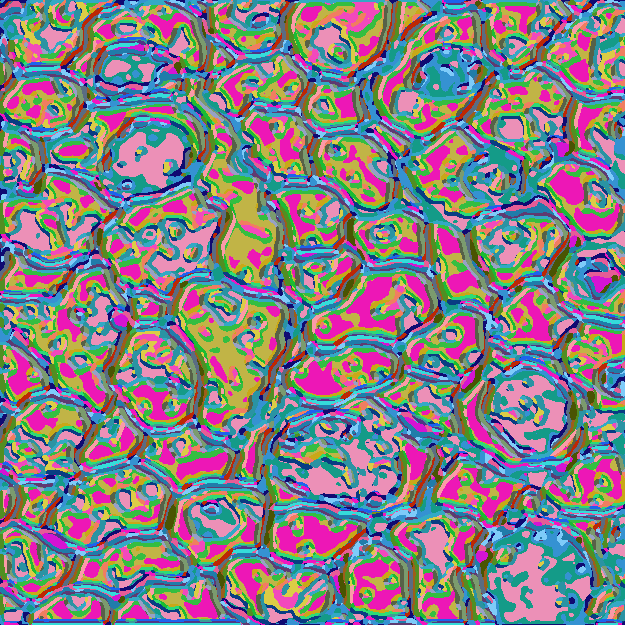

18 / 300 |  label num : 38  | loss : 0.7048723697662354


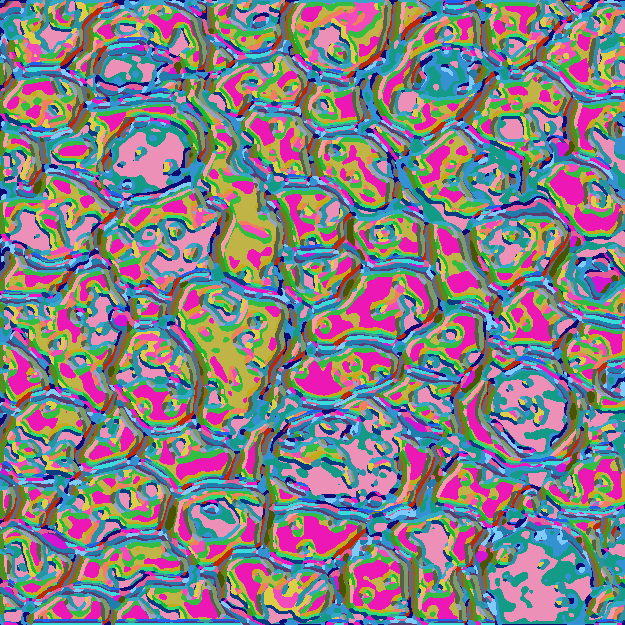

19 / 300 |  label num : 38  | loss : 0.662919282913208


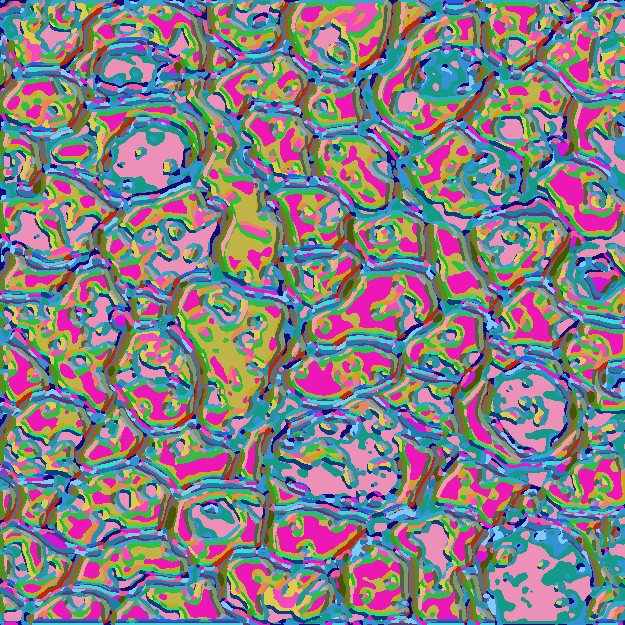

20 / 300 |  label num : 38  | loss : 0.626110851764679


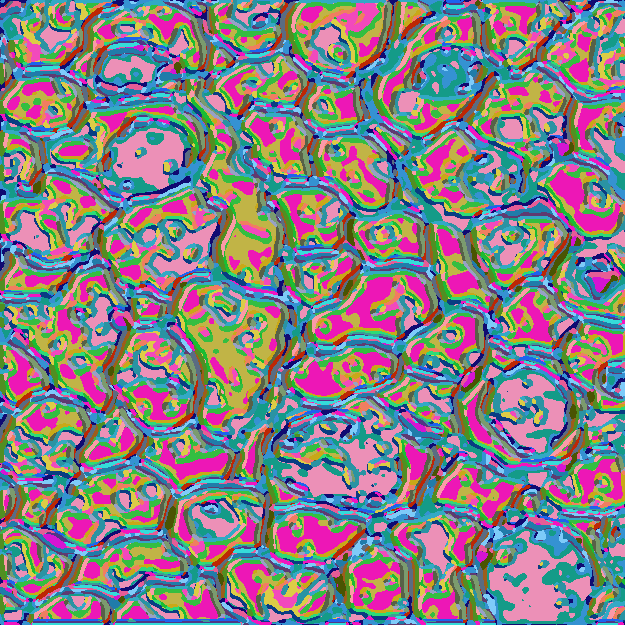

21 / 300 |  label num : 37  | loss : 0.5948240756988525


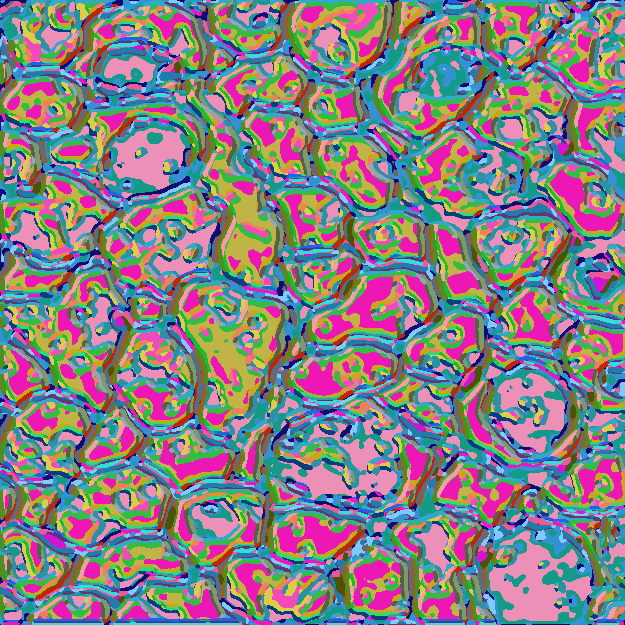

22 / 300 |  label num : 37  | loss : 0.5686724781990051


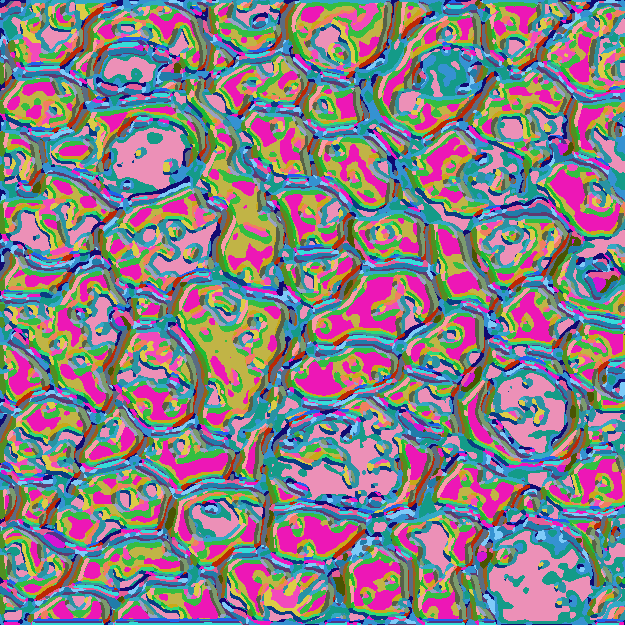

23 / 300 |  label num : 37  | loss : 0.5451908111572266


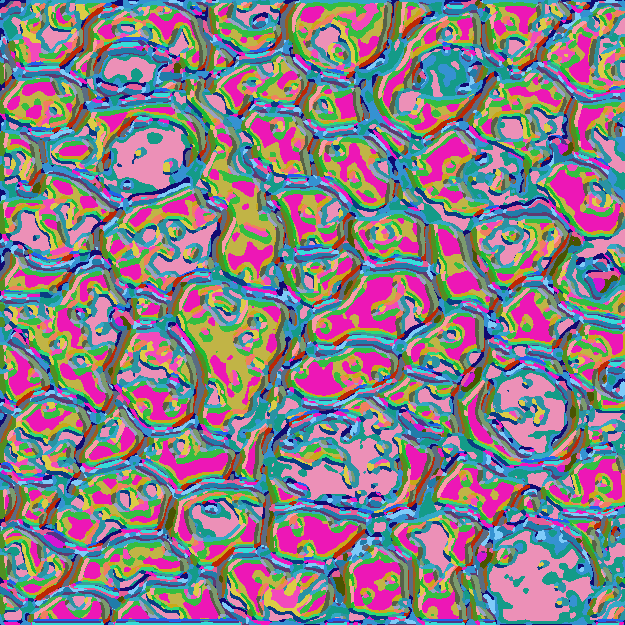

24 / 300 |  label num : 37  | loss : 0.523637056350708


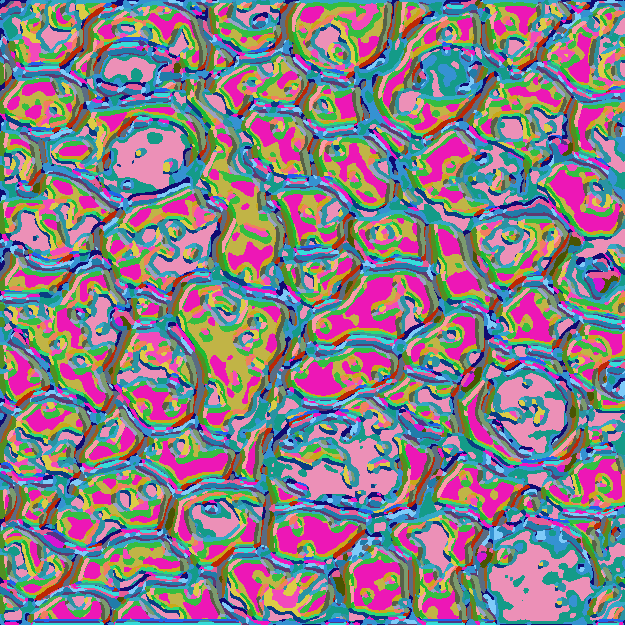

25 / 300 |  label num : 37  | loss : 0.5045684576034546


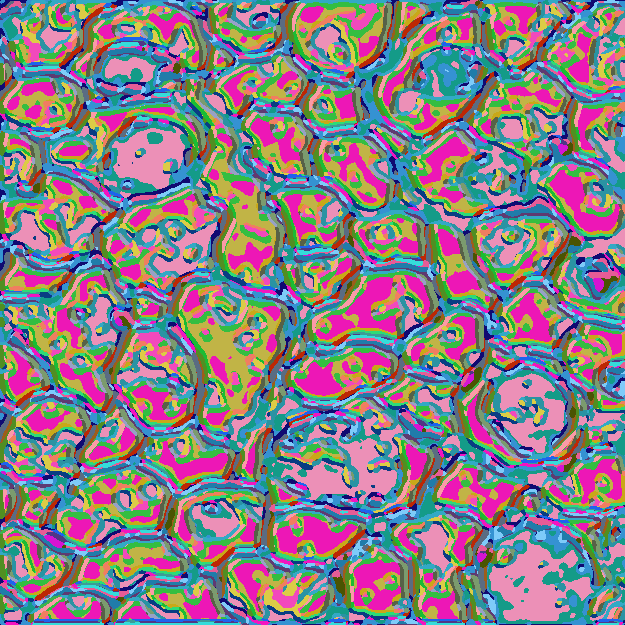

26 / 300 |  label num : 36  | loss : 0.48746082186698914


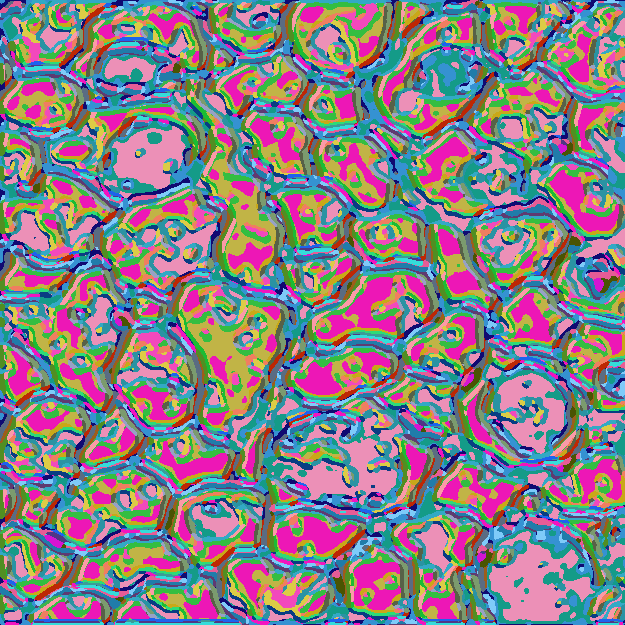

27 / 300 |  label num : 36  | loss : 0.471902072429657


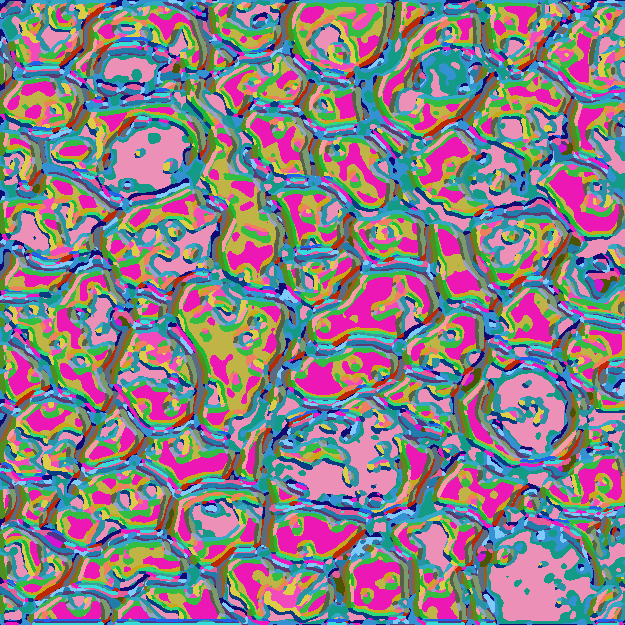

28 / 300 |  label num : 36  | loss : 0.45811009407043457


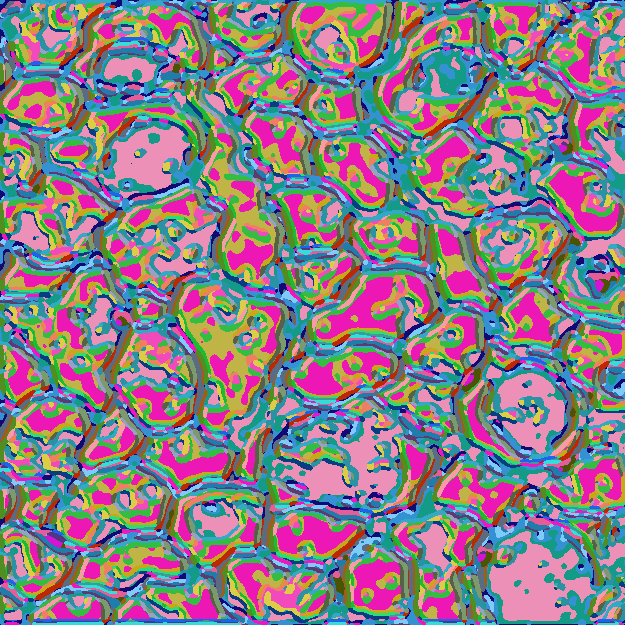

29 / 300 |  label num : 36  | loss : 0.44597184658050537


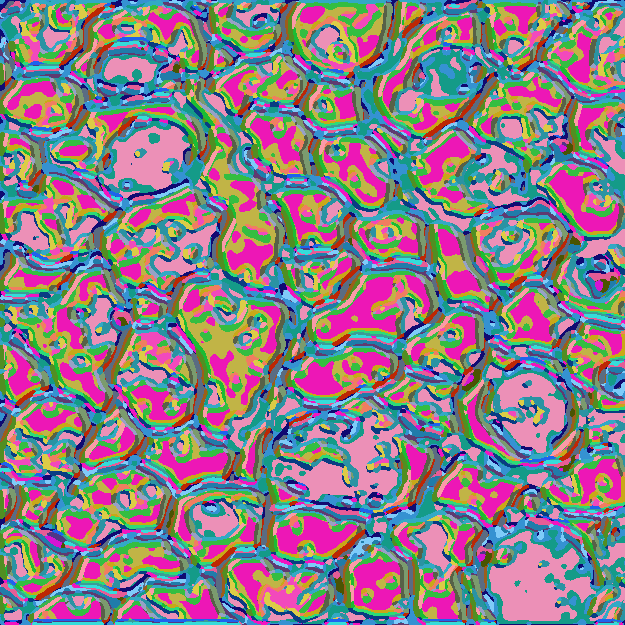

30 / 300 |  label num : 36  | loss : 0.43446099758148193


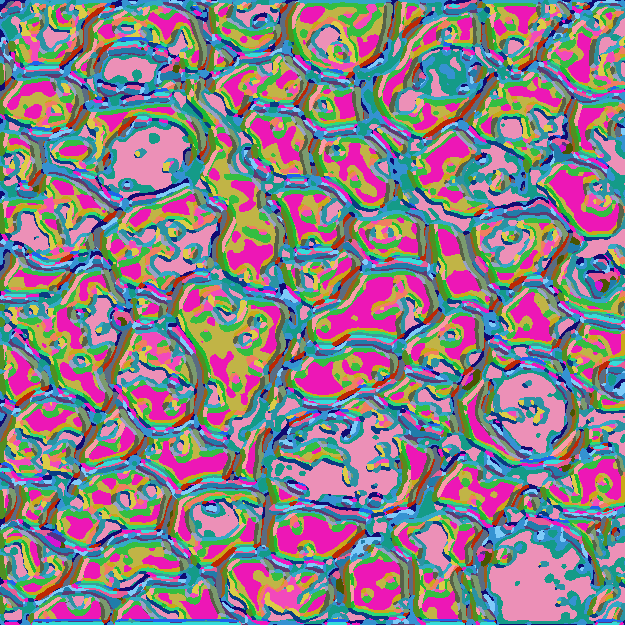

31 / 300 |  label num : 36  | loss : 0.4236486554145813


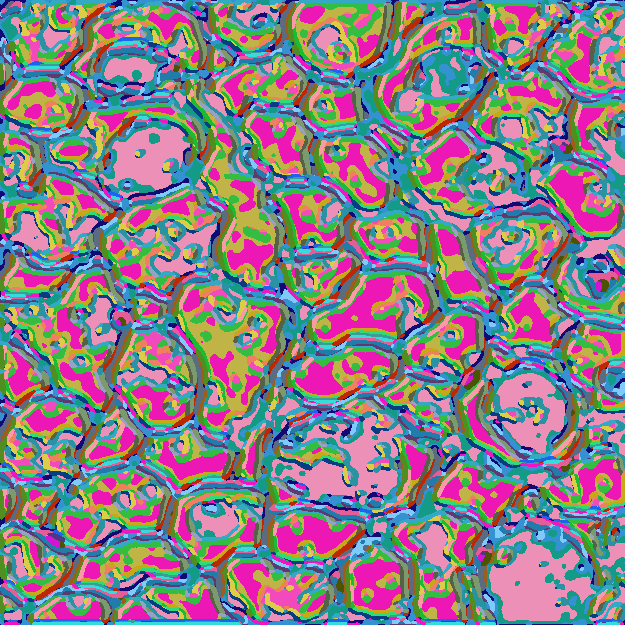

32 / 300 |  label num : 36  | loss : 0.41326940059661865


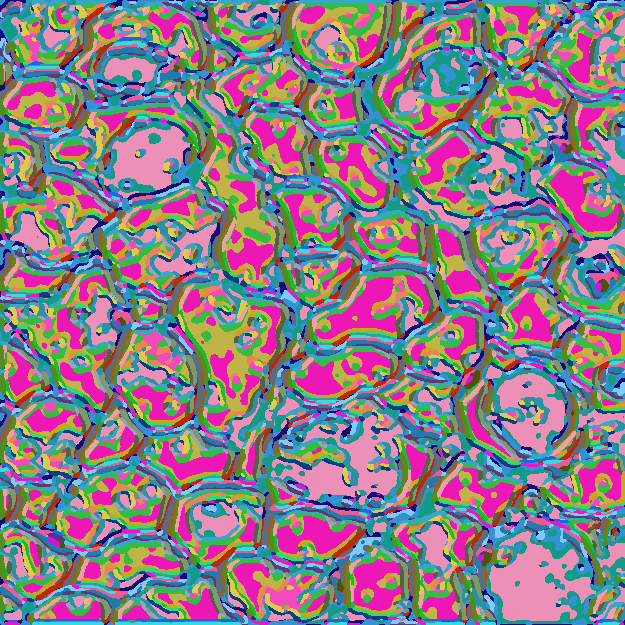

33 / 300 |  label num : 36  | loss : 0.404011607170105


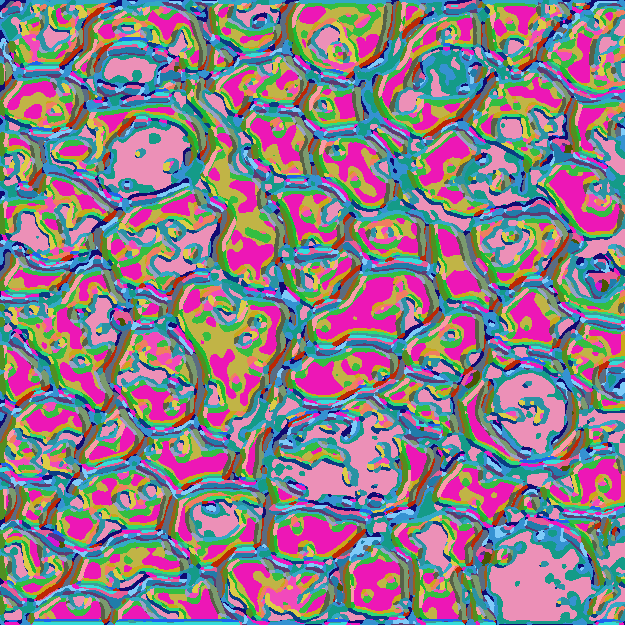

34 / 300 |  label num : 36  | loss : 0.39583340287208557


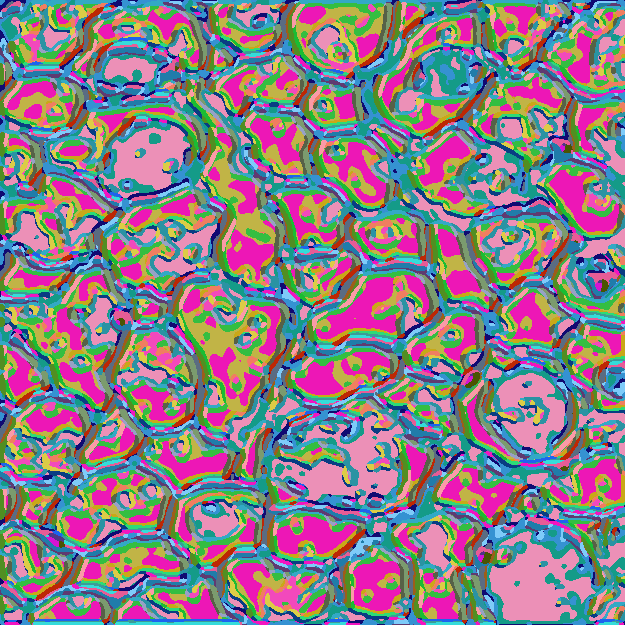

35 / 300 |  label num : 36  | loss : 0.3881031274795532


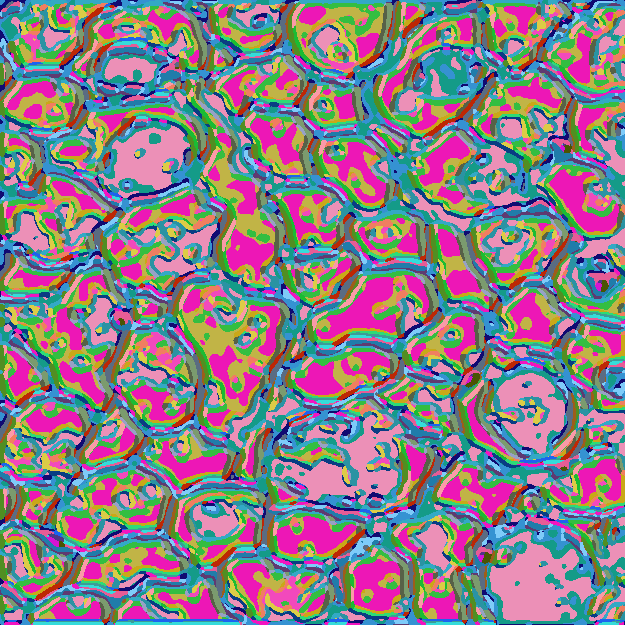

36 / 300 |  label num : 36  | loss : 0.38114964962005615


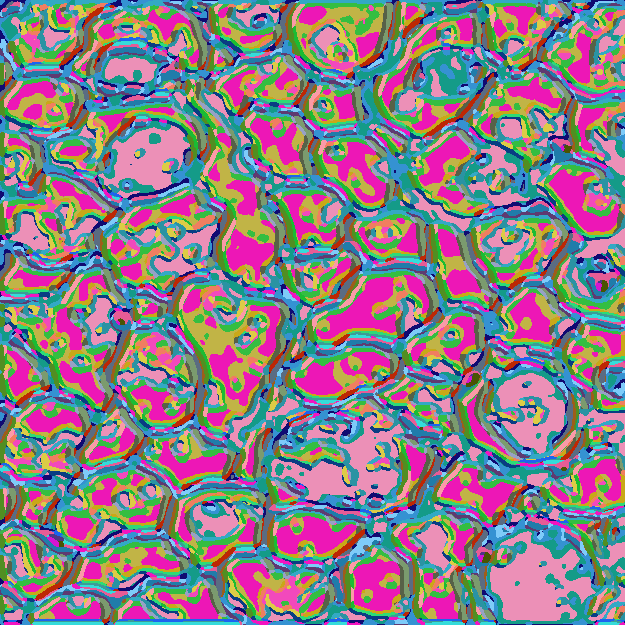

37 / 300 |  label num : 36  | loss : 0.3743788003921509


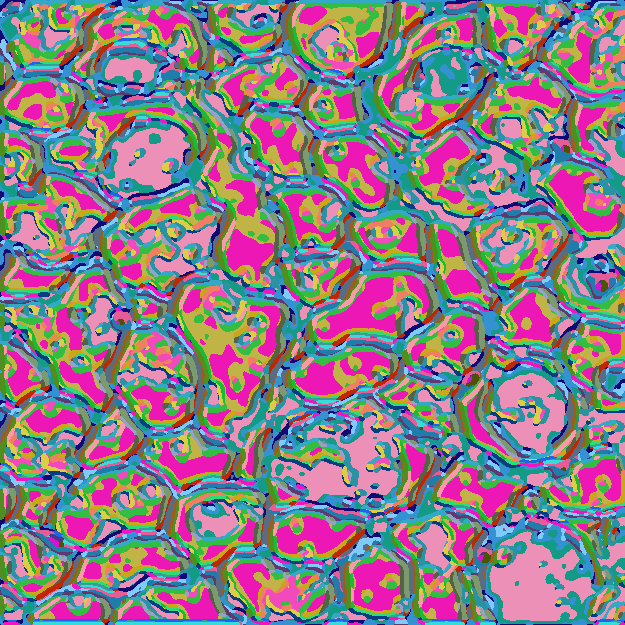

38 / 300 |  label num : 36  | loss : 0.3679862320423126


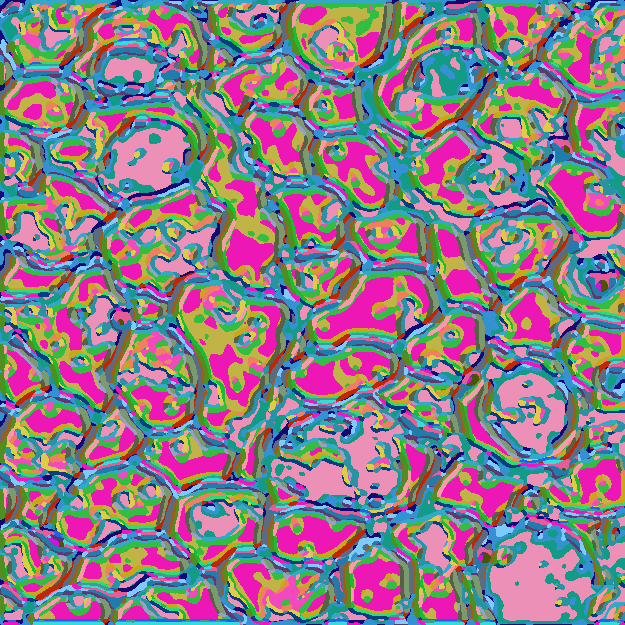

39 / 300 |  label num : 36  | loss : 0.3623664975166321


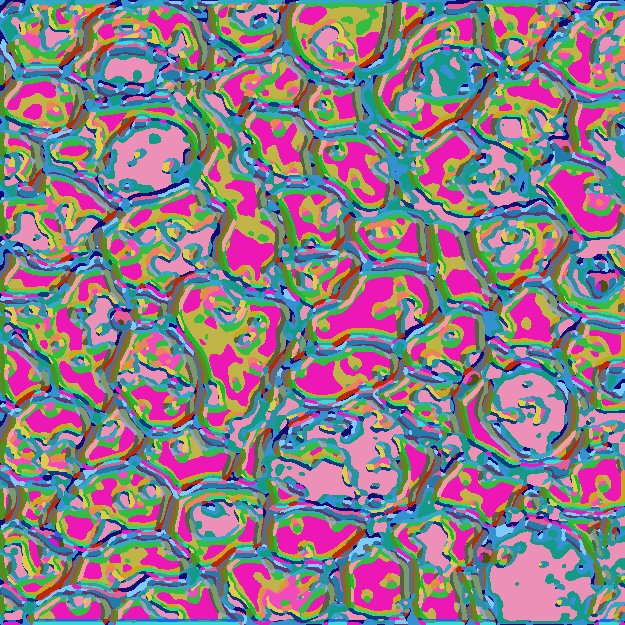

40 / 300 |  label num : 36  | loss : 0.3567820191383362


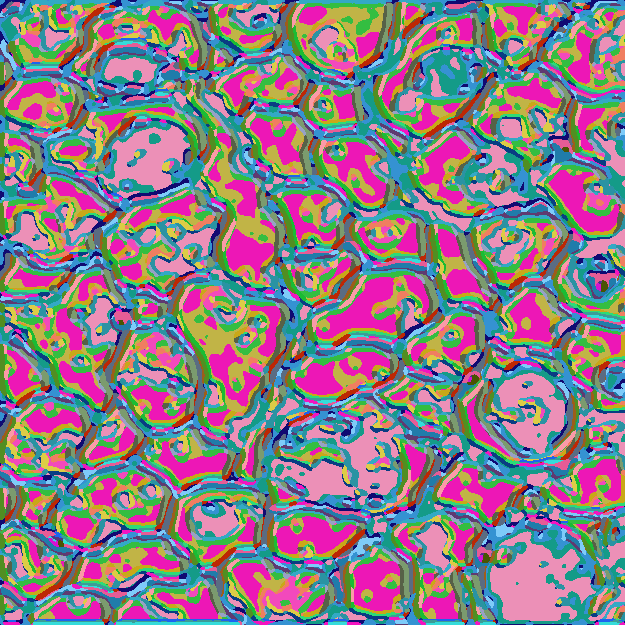

41 / 300 |  label num : 36  | loss : 0.3512365221977234


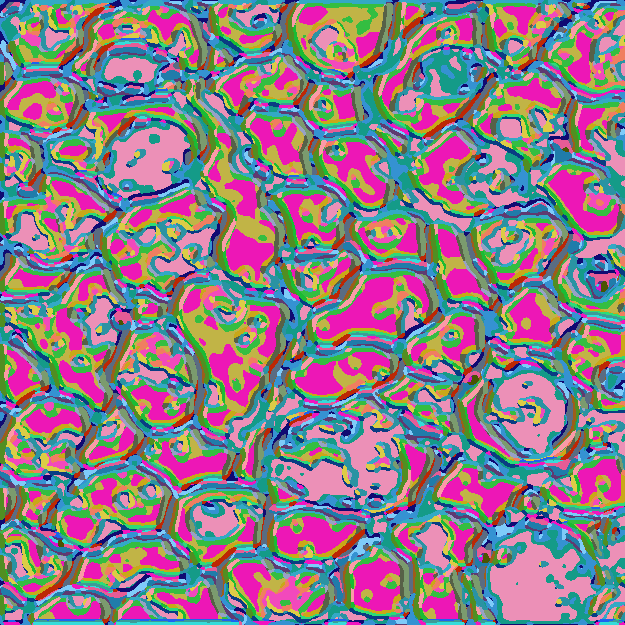

42 / 300 |  label num : 36  | loss : 0.3464343547821045


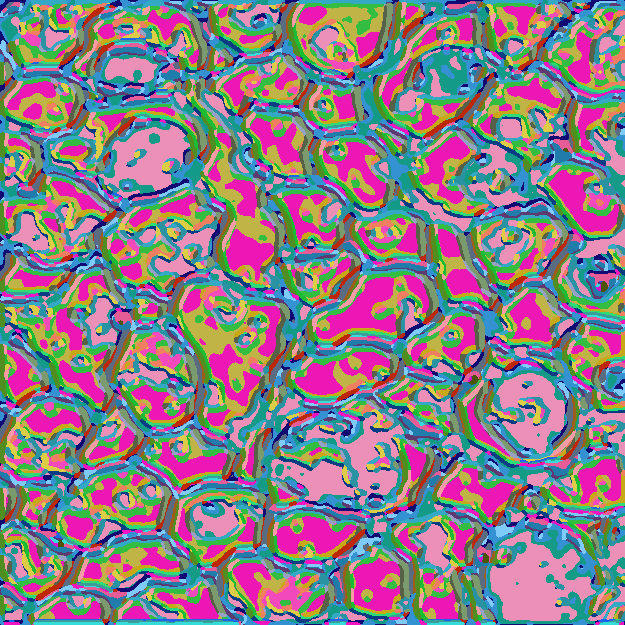

43 / 300 |  label num : 36  | loss : 0.3416101932525635


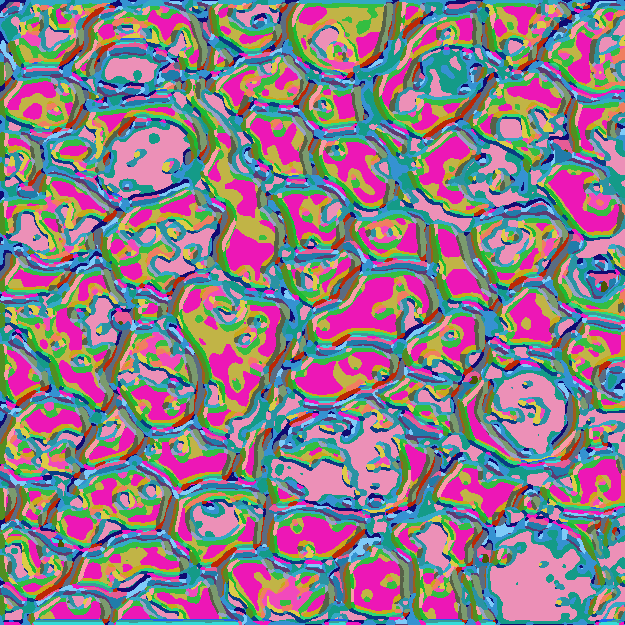

44 / 300 |  label num : 36  | loss : 0.3371782898902893


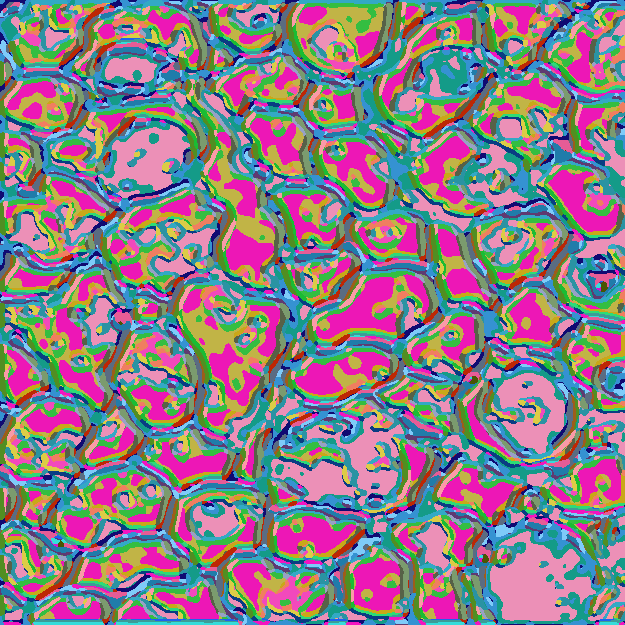

45 / 300 |  label num : 36  | loss : 0.33319246768951416


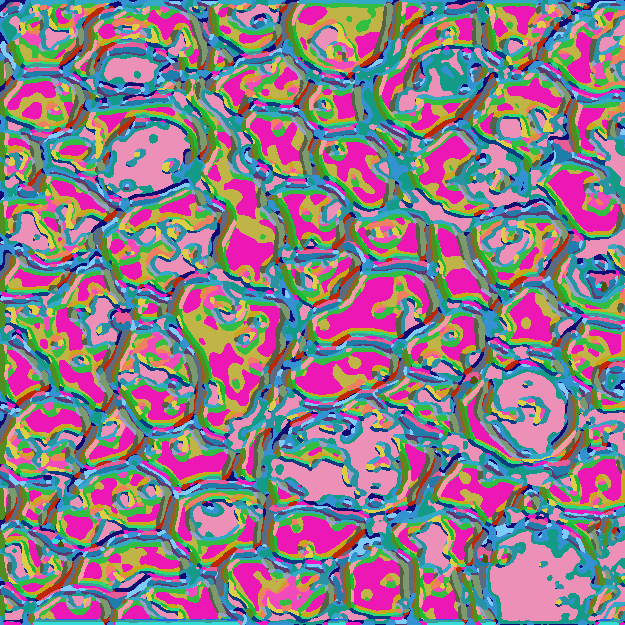

46 / 300 |  label num : 36  | loss : 0.32998979091644287


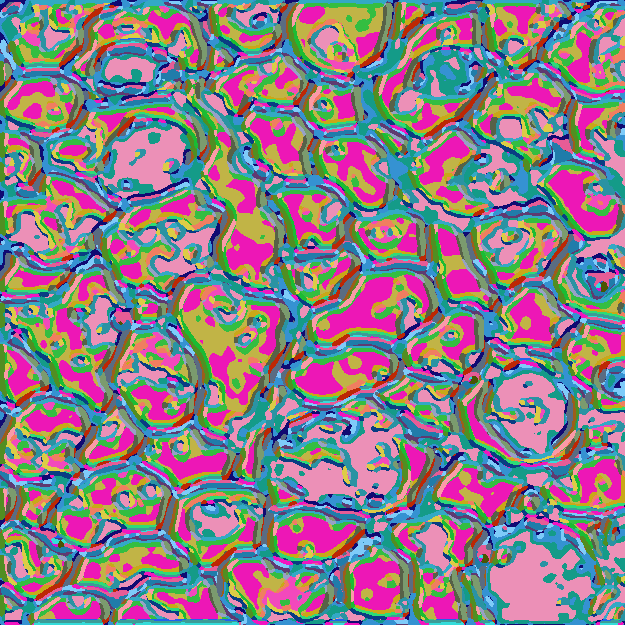

47 / 300 |  label num : 36  | loss : 0.33051177859306335


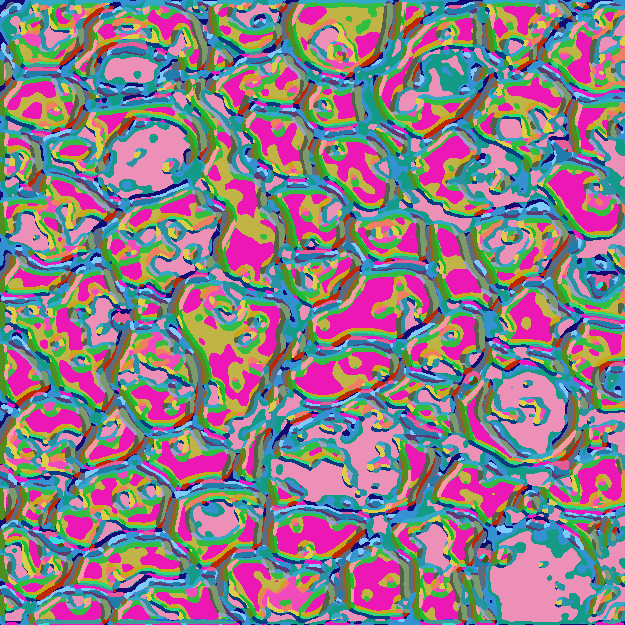

48 / 300 |  label num : 35  | loss : 0.32613664865493774


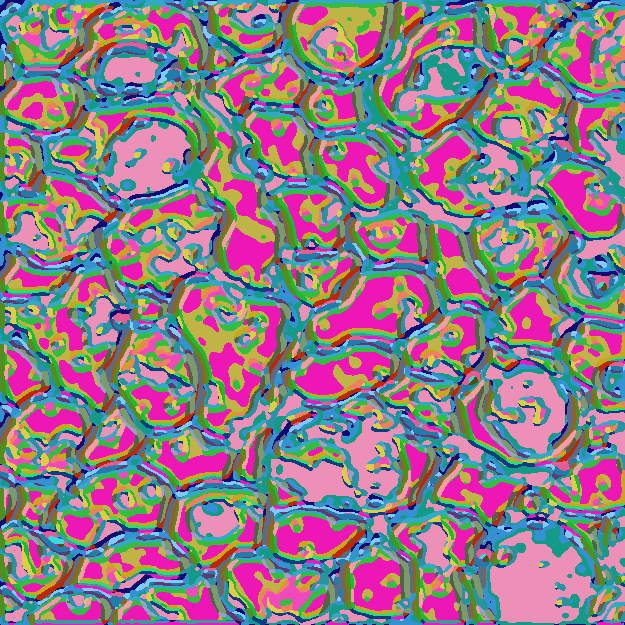

49 / 300 |  label num : 35  | loss : 0.3236047029495239


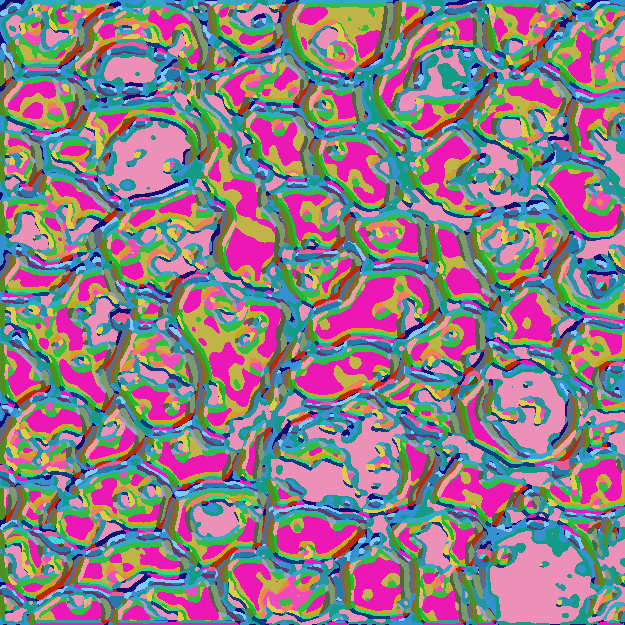

50 / 300 |  label num : 35  | loss : 0.31897643208503723


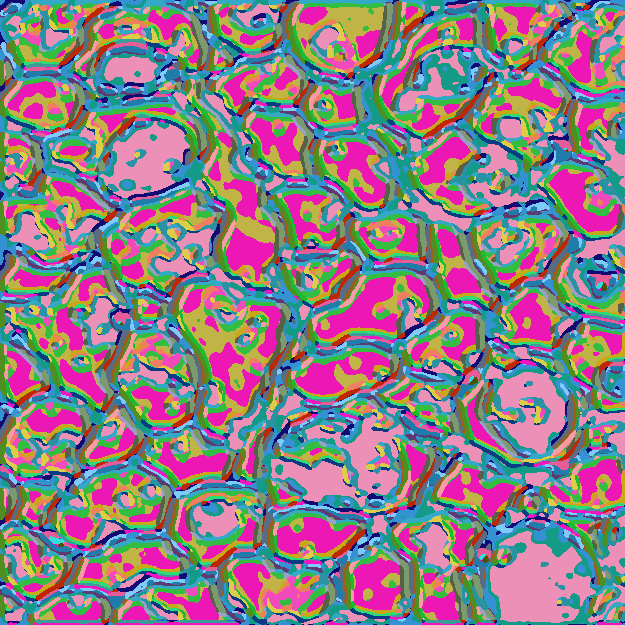

51 / 300 |  label num : 36  | loss : 0.31546562910079956


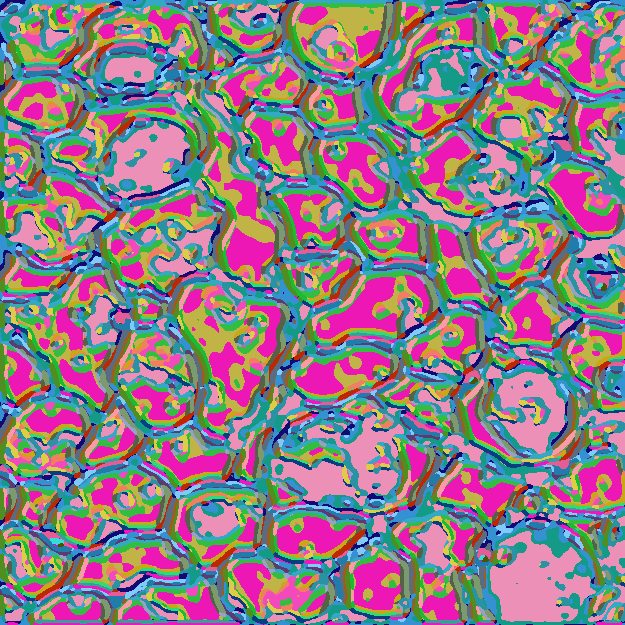

52 / 300 |  label num : 36  | loss : 0.3110736906528473


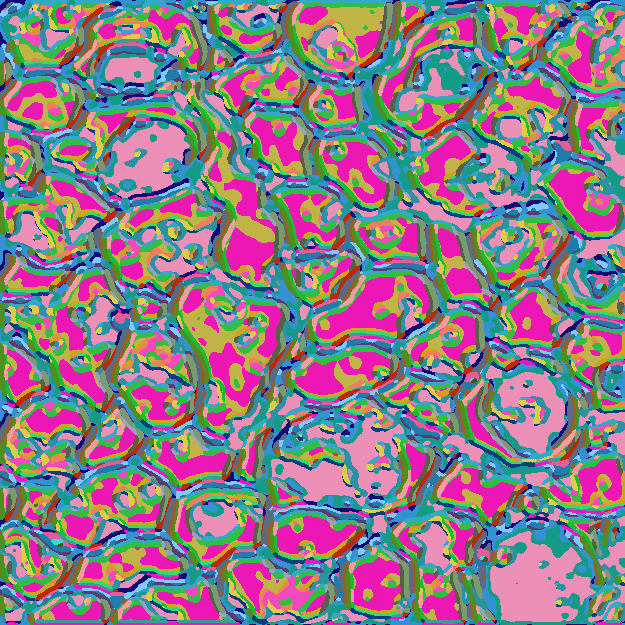

53 / 300 |  label num : 35  | loss : 0.30768829584121704


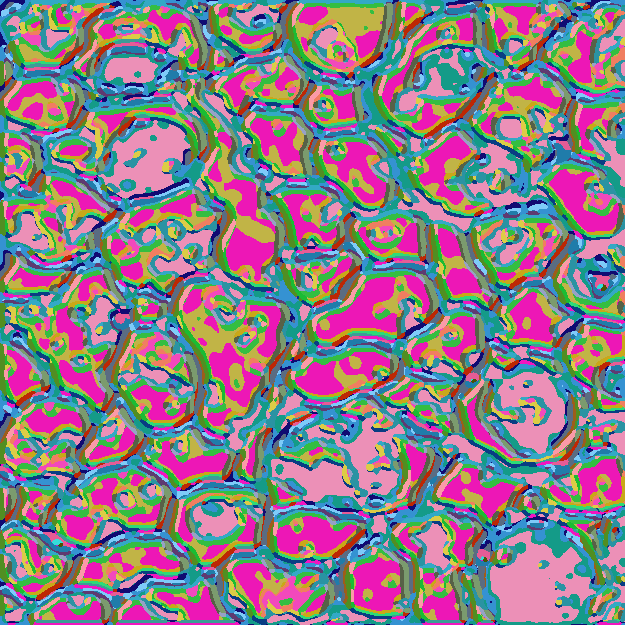

54 / 300 |  label num : 34  | loss : 0.3045414686203003


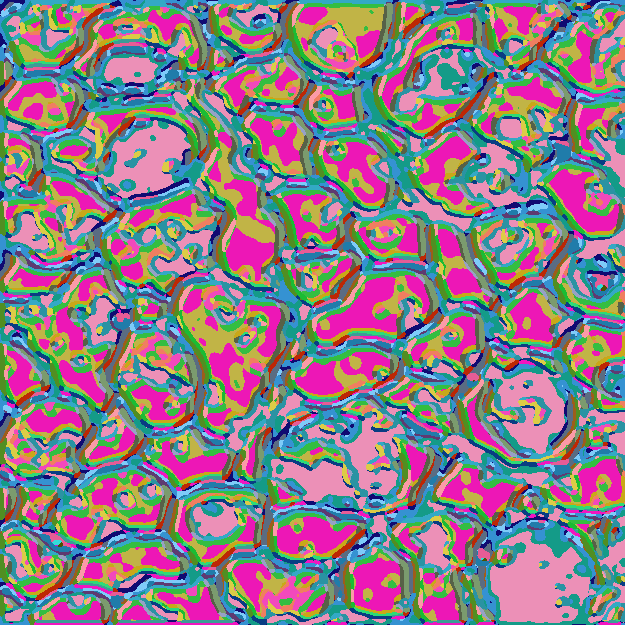

55 / 300 |  label num : 34  | loss : 0.3004642724990845


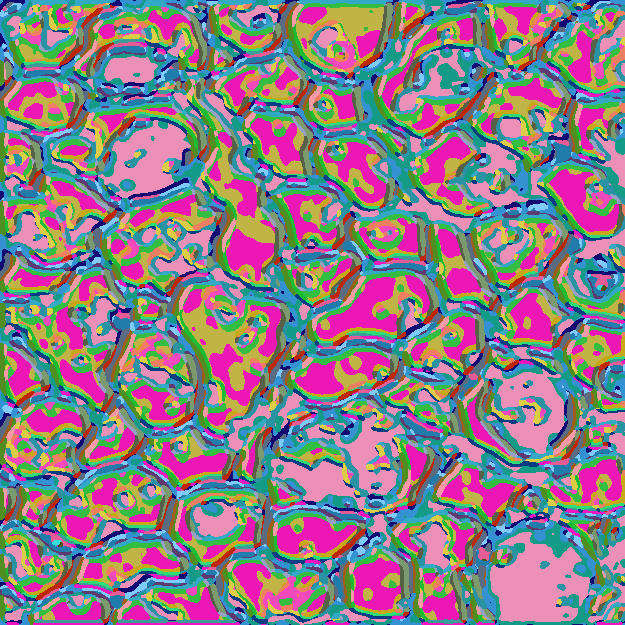

56 / 300 |  label num : 34  | loss : 0.2983904182910919


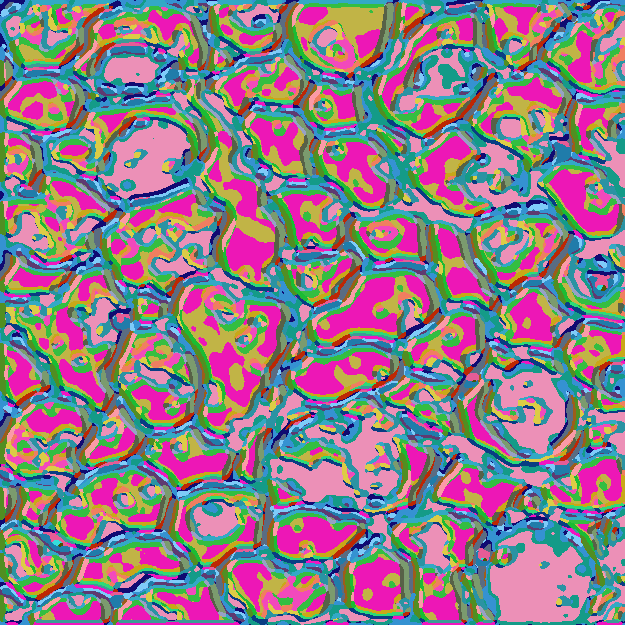

57 / 300 |  label num : 34  | loss : 0.29555177688598633


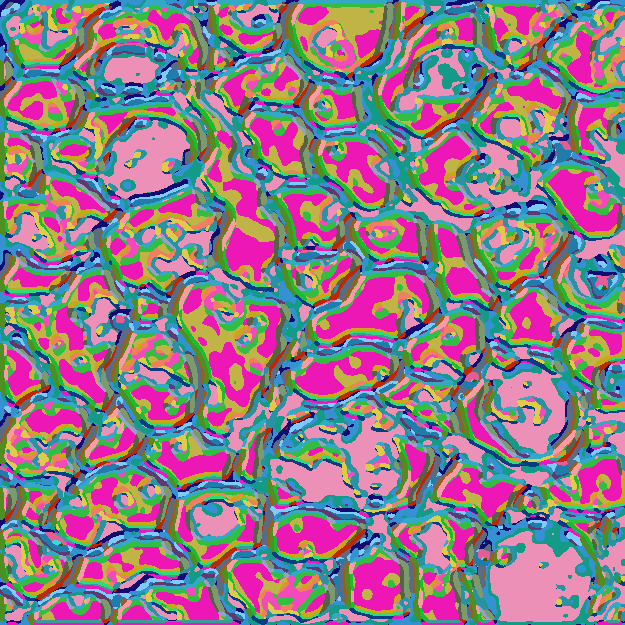

58 / 300 |  label num : 33  | loss : 0.2947946786880493


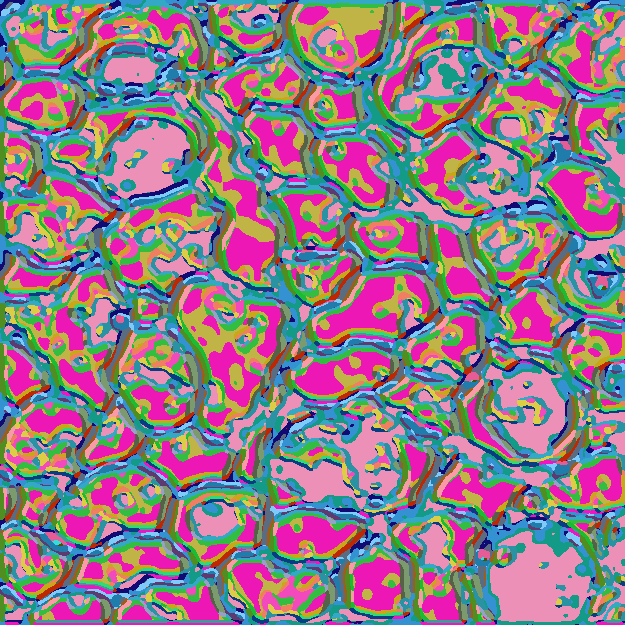

59 / 300 |  label num : 33  | loss : 0.2914257049560547


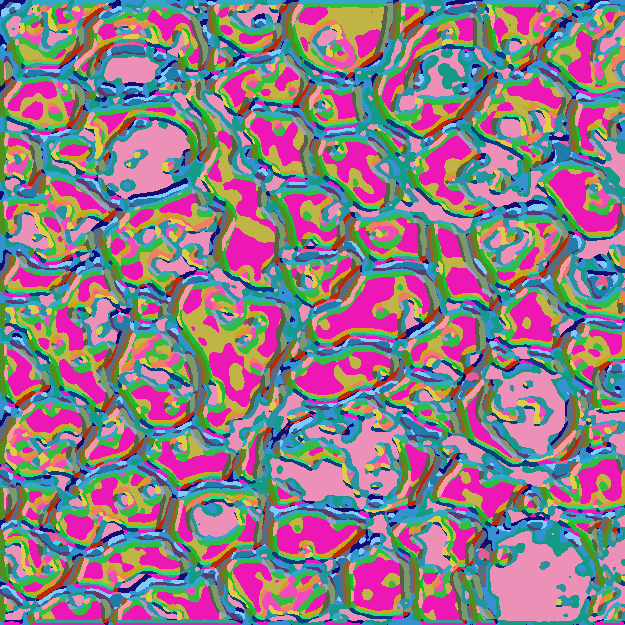

60 / 300 |  label num : 33  | loss : 0.28813958168029785


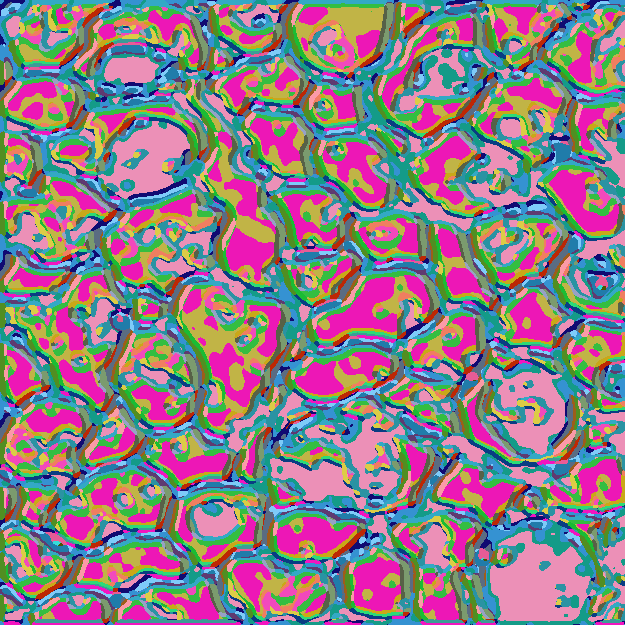

61 / 300 |  label num : 32  | loss : 0.28577443957328796


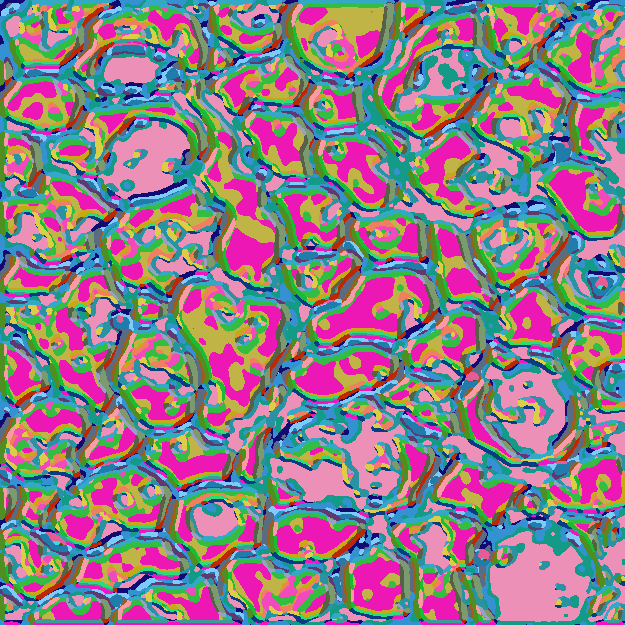

62 / 300 |  label num : 32  | loss : 0.28286290168762207


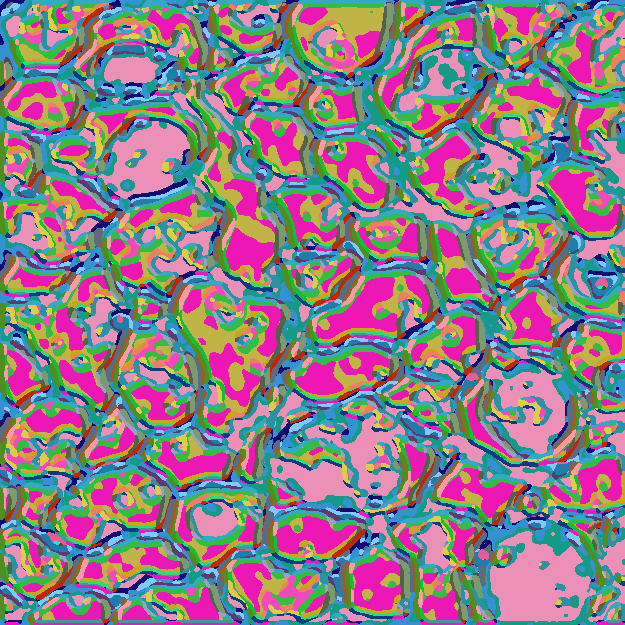

63 / 300 |  label num : 32  | loss : 0.28009840846061707


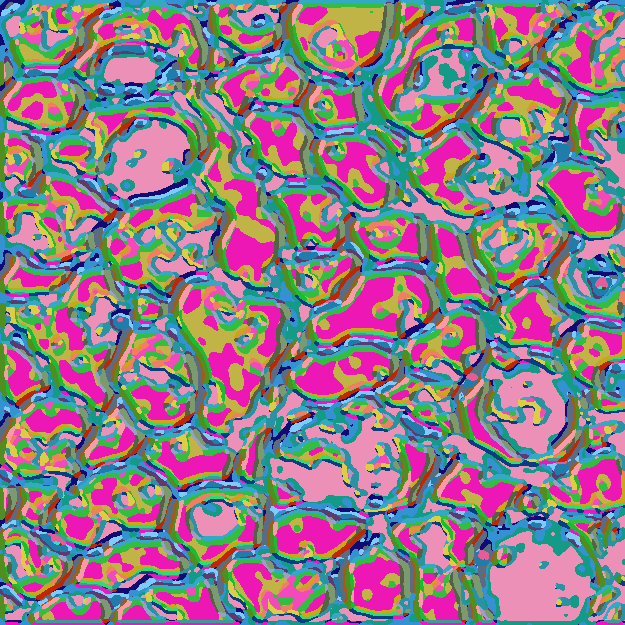

64 / 300 |  label num : 32  | loss : 0.2775319218635559


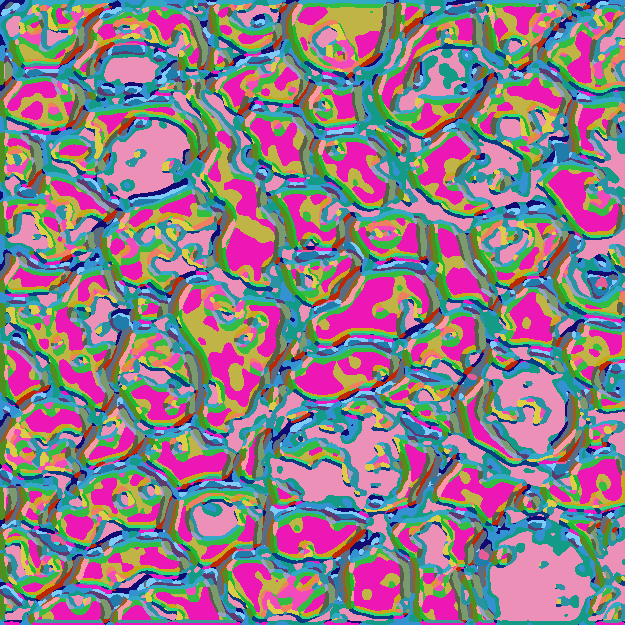

65 / 300 |  label num : 32  | loss : 0.2753666043281555


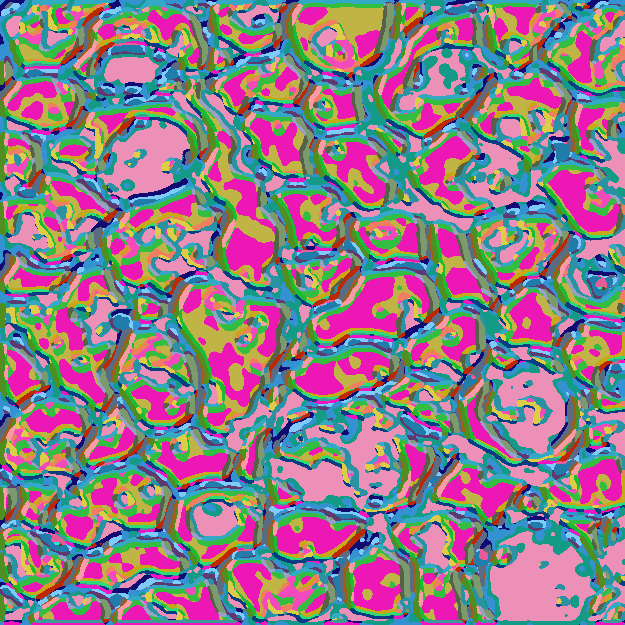

66 / 300 |  label num : 32  | loss : 0.2725256383419037


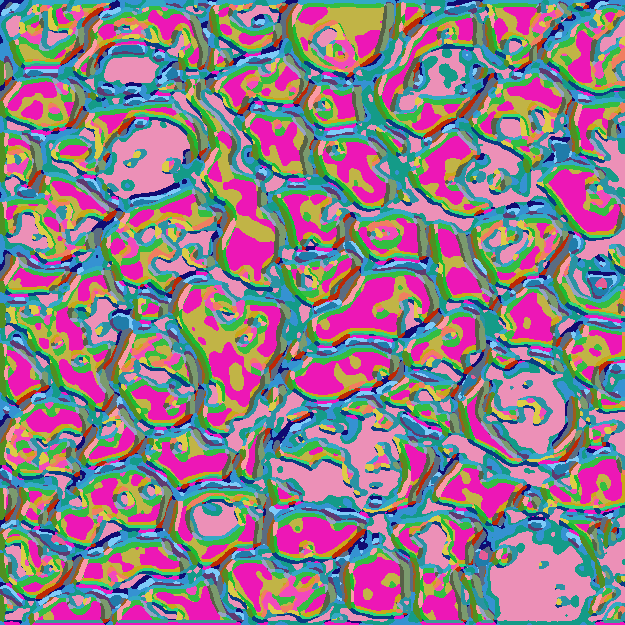

67 / 300 |  label num : 32  | loss : 0.27035391330718994


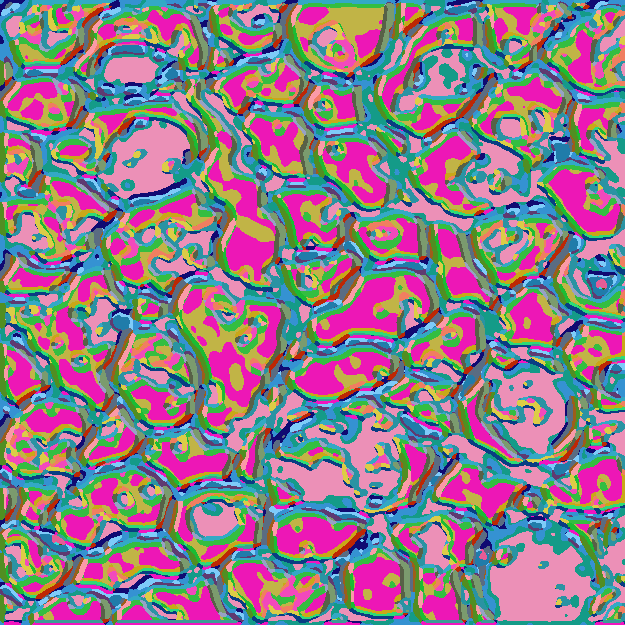

68 / 300 |  label num : 32  | loss : 0.26766520738601685


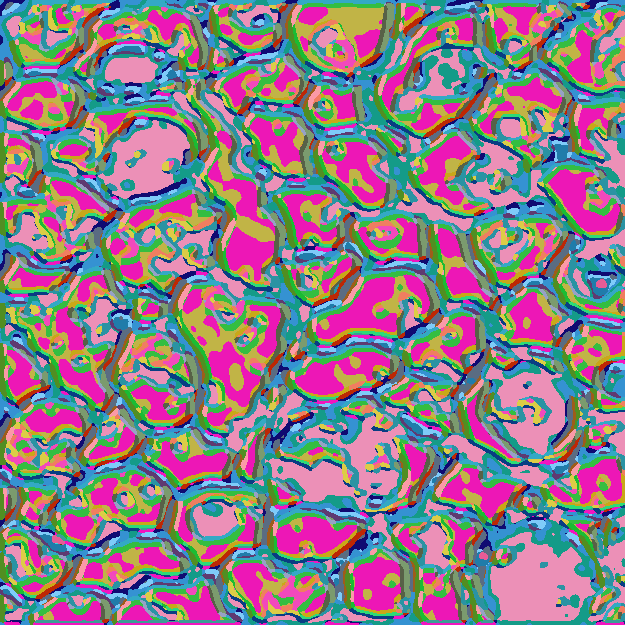

69 / 300 |  label num : 32  | loss : 0.2663860023021698


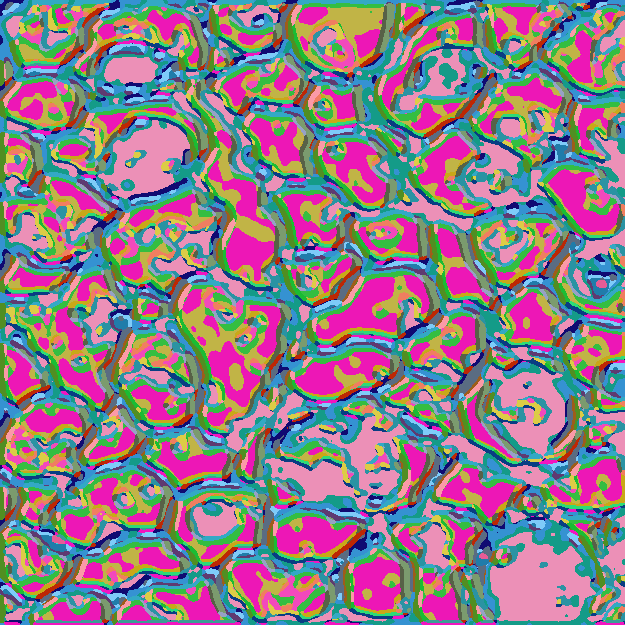

70 / 300 |  label num : 31  | loss : 0.264219731092453


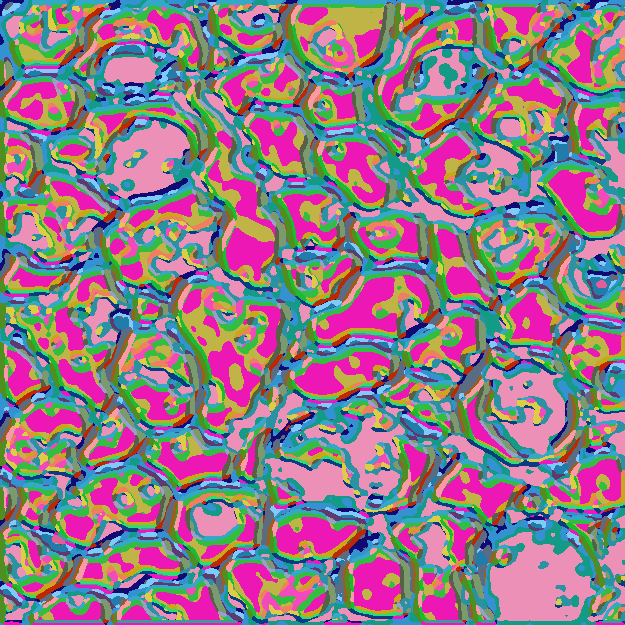

71 / 300 |  label num : 32  | loss : 0.2640112638473511


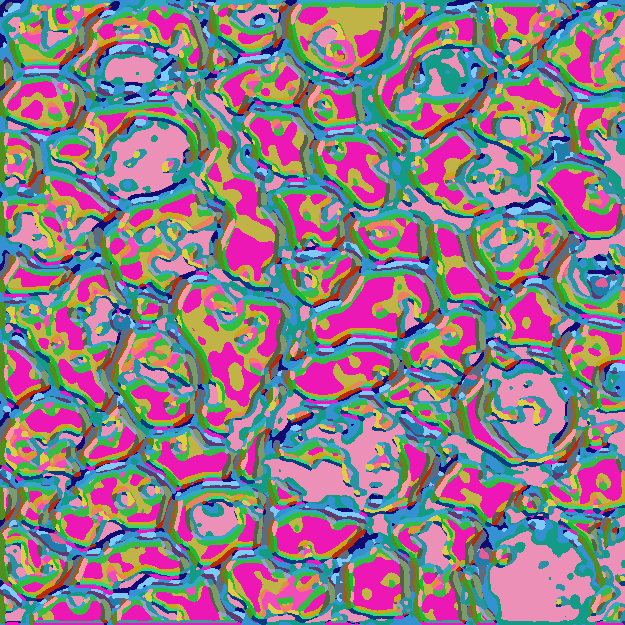

72 / 300 |  label num : 31  | loss : 0.26577940583229065


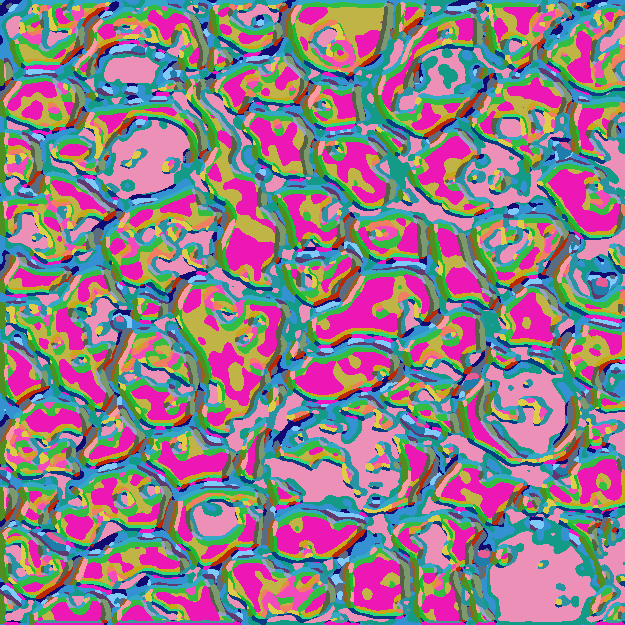

73 / 300 |  label num : 31  | loss : 0.26549988985061646


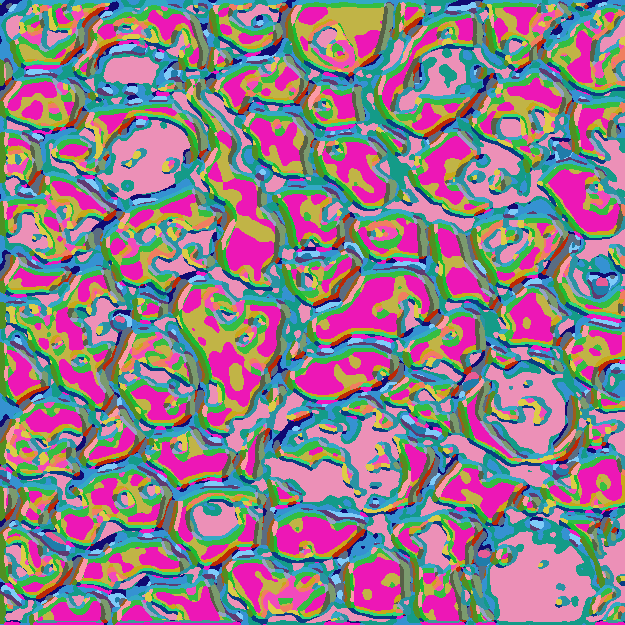

74 / 300 |  label num : 31  | loss : 0.2634465992450714


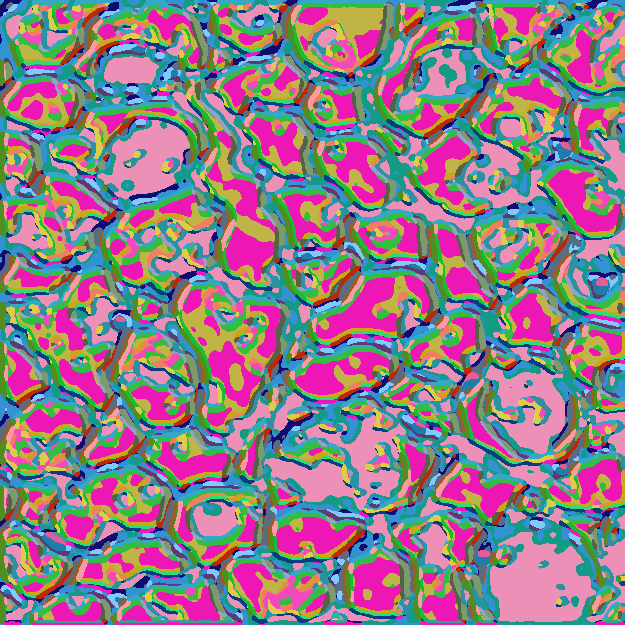

75 / 300 |  label num : 30  | loss : 0.26051944494247437


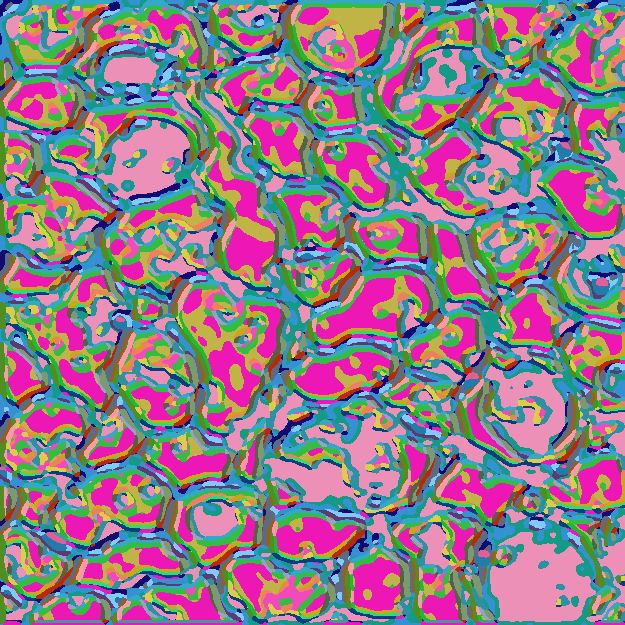

76 / 300 |  label num : 30  | loss : 0.25888413190841675


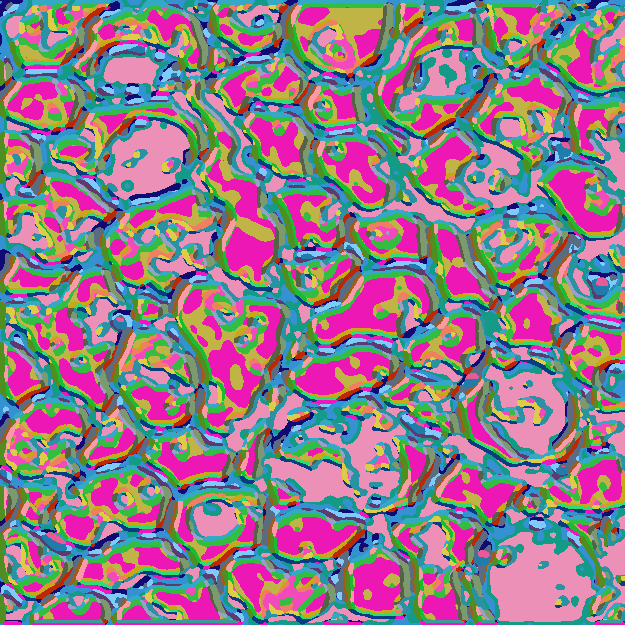

77 / 300 |  label num : 30  | loss : 0.25728410482406616


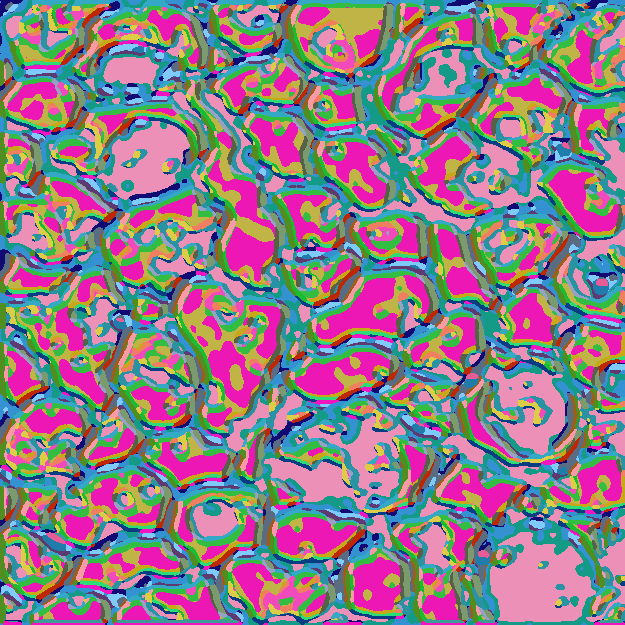

78 / 300 |  label num : 30  | loss : 0.2548980116844177


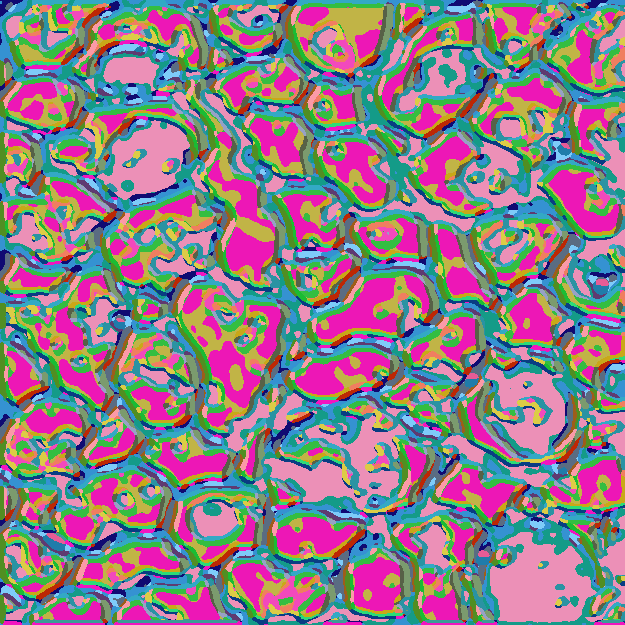

79 / 300 |  label num : 30  | loss : 0.2532220482826233


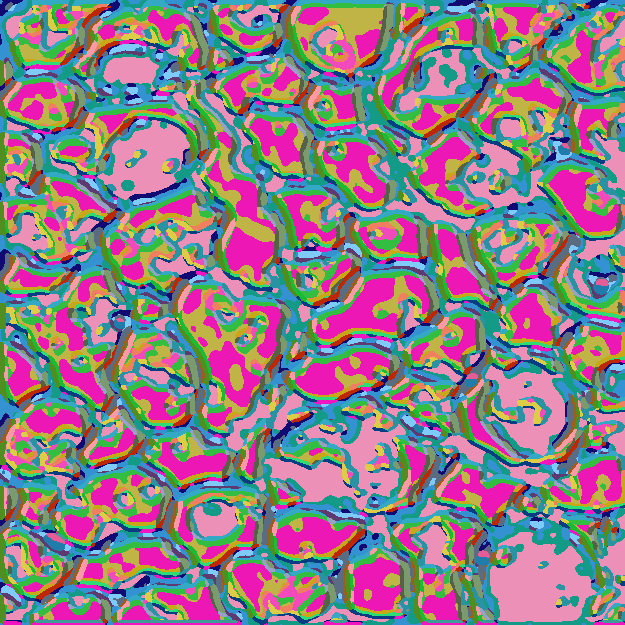

80 / 300 |  label num : 30  | loss : 0.25161638855934143


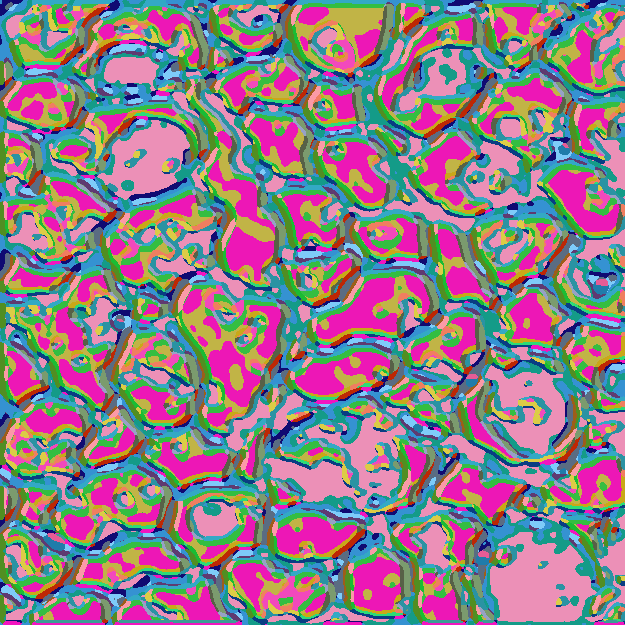

81 / 300 |  label num : 30  | loss : 0.2487005889415741


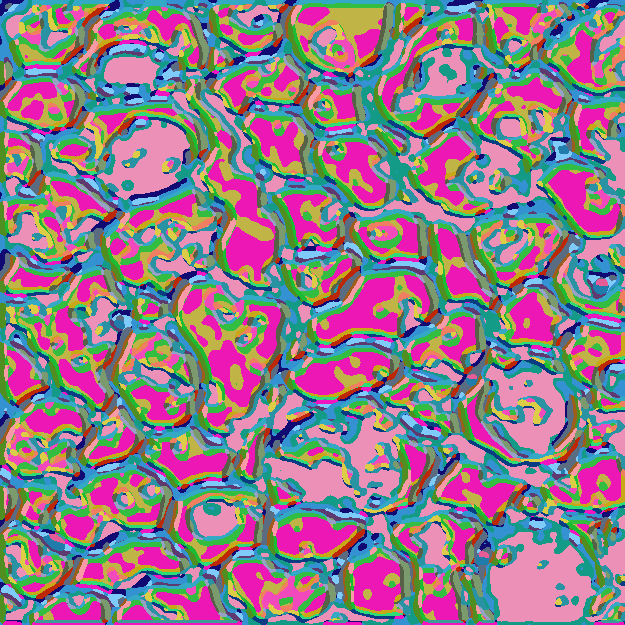

82 / 300 |  label num : 30  | loss : 0.2479567974805832


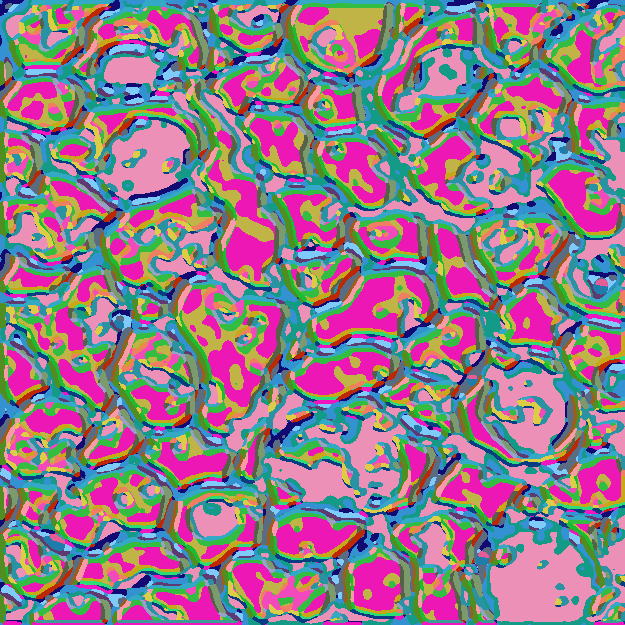

83 / 300 |  label num : 30  | loss : 0.24604812264442444


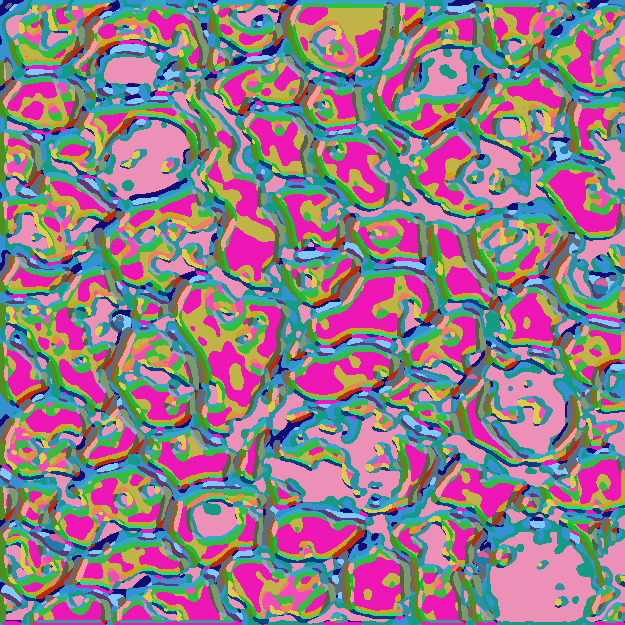

84 / 300 |  label num : 30  | loss : 0.24437639117240906


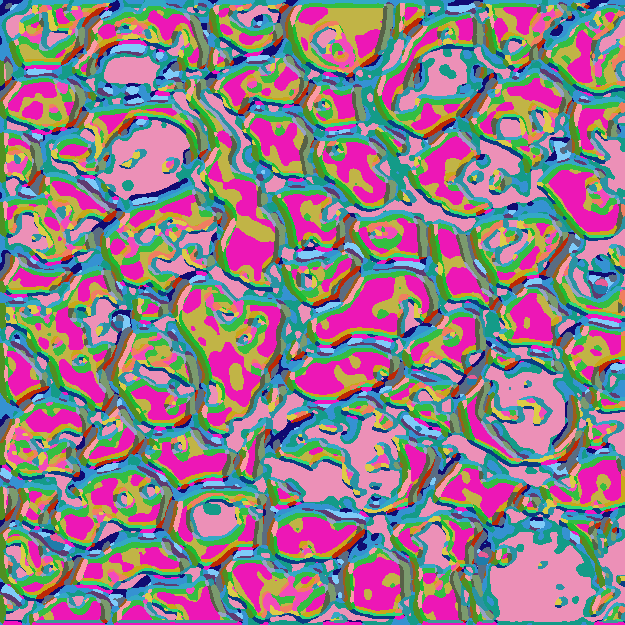

85 / 300 |  label num : 30  | loss : 0.24305838346481323


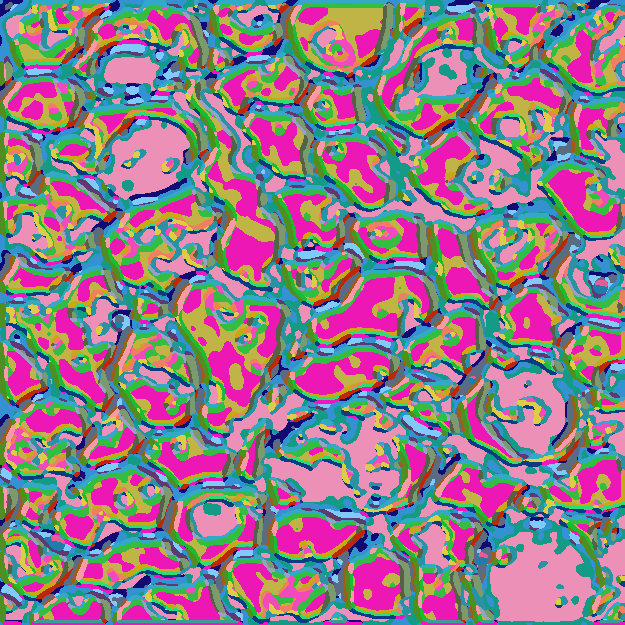

86 / 300 |  label num : 30  | loss : 0.2415587604045868


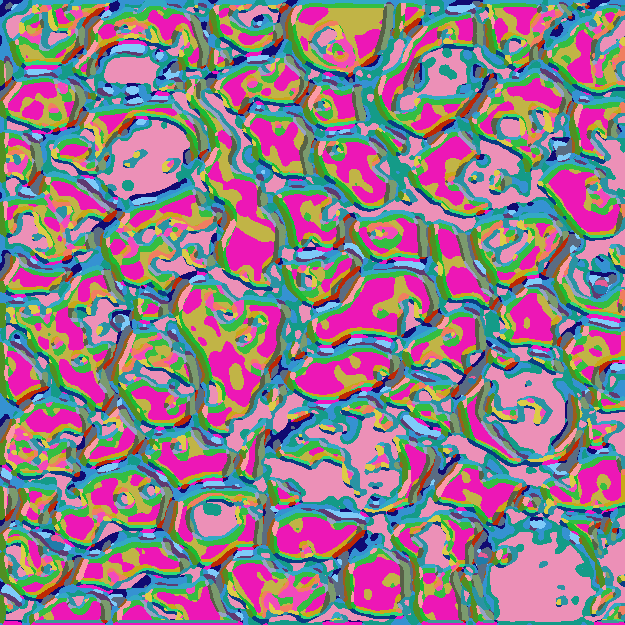

87 / 300 |  label num : 30  | loss : 0.2398984432220459


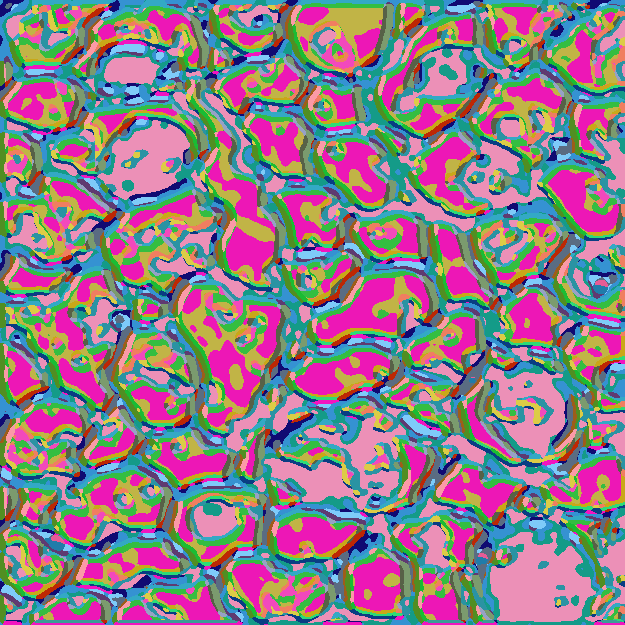

88 / 300 |  label num : 30  | loss : 0.23759302496910095


KeyboardInterrupt: ignored

In [ ]:
unsupervised_differentiable_clustering(input='/content/drive/MyDrive/Colab Notebooks/EM_DATA/EM_testA_up_left.jpg', maxIter=300, nConv=10, output_name='testA_default_orig_resolution_up_left.jpg')